Connected to .venv (Python 3.11.9)

In [ ]:
""" Jeongwon Kim, Akiva, Omrie, Wei  IQCC, 250924
Sweep pump frequency and amplitude
For each pumping point, calculate Gain, SNR improvement.
Optimize pumping point for the worst SNR Qubit so that the multiplexed readout could be done faster in the given fidelity.

Prerequisites:
    - Need to know in which frequency dispersive feature of TWPA RPM resonator appears
    - Having calibrated the resonator frequency (nodes 02a, 02b and/or 02c).
    - Having calibrated the worst SNR Qubit 

* Gain is defined as the increase in the signal level.
    - twpa pump off : measure the signal response within  a 4MHz around the readout resonator
      singal_off= signal[dB] 
    - twpa pump on :  measure signal response within the same 4MHz around the readout resonator
      singal_on= signal[dB]
    => gain=signal_on-signal_off
* SNR improvement is defined using OPX1000 as Spectrum Analyzer.
    - twpa pump off : measure within a 4 MHz window around the readout resonator twice
      measure(amp=0) for noise level
      measure(amp=from state file) for signal level
      snr_off= signal[dB]-noise[dB]
    - twpa pump on :  measure within a 4 MHz window around the readout resonator twice
      measure(amp=0) for noise level
      measure(amp=from state file) for signal level
    => dsnr=snr_on-snr_off
"""

# %% {Imports}
from datetime import datetime, timezone, timedelta
from iqcc_calibration_tools.qualibrate_config.qualibrate.node import QualibrationNode, NodeParameters
from iqcc_calibration_tools.quam_config.components.quam_root import Quam
from iqcc_calibration_tools.quam_config.macros import qua_declaration
from iqcc_calibration_tools.quam_config.lib.qua_datasets import convert_IQ_to_V
from iqcc_calibration_tools.storage.save_utils import fetch_results_as_xarray
from iqcc_calibration_tools.analysis.twpa_utils import  * 
from qualang_tools.results import  fetching_tool
from qualang_tools.loops import from_array
from qualang_tools.multi_user import qm_session
from qualang_tools.units import unit
from qm import SimulationConfig
from qm.qua import *
from typing import Literal, Optional, List
import matplotlib.pyplot as plt
import numpy as np
import math
from iqcc_calibration_tools.quam_config.lib.qua_datasets import opxoutput

2026-01-17 18:07:58,128 - qm - INFO     - Starting session: 22efe089-efca-46d8-9e1b-9d4eff99e65a


c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\qm\results\__init__.py:15: DeprecationWarning: qm.results is deprecated since "1.2.3" and will be removed in "1.3.0". If you need anything from this module, import it directly from `qm` or from `qm.simulate` for simulator-related functionality.
  warnings.warn(


In [ ]:
class Parameters(NodeParameters):
    twpas: Optional[List[str]] = ['twpa1-3']
    num_averages: int =30
    amp_min: float =  0.1
    amp_max: float =  0.3
    points : int = 40
    frequency_span_in_mhz: float = 4
    frequency_step_in_mhz: float = 0.1
    p_frequency_span_in_mhz: float = 60
    p_frequency_step_in_mhz: float =0.5
    flux_point_joint_or_independent: Literal["joint", "independent"] = "joint"
    simulate: bool = False
    simulation_duration_ns: int = 4000
    timeout: int = 300
    load_data_id: Optional[int] = None
    pumpline_attenuation: int = -50-5 #(-50: fridge atten(-30)+directional coupler(-20))  
    signalline_attenuation : int = -60-5 #-60dB : fridge atten
node = QualibrationNode(name="00a_twpa1_3_calibration_MTPLX_RO", parameters=Parameters())
date_time = datetime.now(timezone(timedelta(hours=2))).strftime("%Y-%m-%d %H:%M:%S")
node.results["date"]={"date":date_time}

2026-01-17 18:08:01,793 - qualibrate - INFO - Creating node 00a_twpa1_3_calibration_MTPLX_RO


In [ ]:
# Class containing tools to help handling units and conversions.
u = unit(coerce_to_integer=True)
# Instantiate the QuAM class from the state file
machine = Quam.load()

# Get the relevant QuAM components
twpas = [machine.twpas[t] for t in node.parameters.twpas]
twpa_=node.parameters.twpas[0]
qubits = [machine.qubits[machine.twpas[twpa_].qubits[i]] for i in range(len(machine.twpas[twpa_].qubits))]
resonators = [machine.qubits[machine.twpas[twpa_].qubits[i]].resonator for i in range(len(machine.twpas[twpa_].qubits))]

# Generate the OPX and Octave configurations
config = machine.generate_config()
# Open Communication with the QOP
if node.parameters.load_data_id is None:
    qmm = machine.connect()

c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\quam\components\channels.py:636: UserWarning: The 'thread' element argument is deprecated from qm.qua >= 1.2.2. Use 'core' instead.
  warnings.warn(


In [ ]:
readout_power=[np.round(opxoutput(qubits[i].resonator.opx_output.full_scale_power_dbm,qubits[i].resonator.operations["readout"].amplitude)+node.parameters.signalline_attenuation,2) for i in range(len(qubits))]
readout_length=[qubits[i].resonator.operations["readout"].length for i in range(len(qubits))]
for i in range(len(readout_power)):
    print(f"{qubits[i].name}: readout power @ resonator={readout_power[i]}dBm, readout length={readout_length[i]}, Aro={qubits[i].resonator.operations['readout'].amplitude} ")

qB2: readout power @ resonator=-102.45dBm, readout length=1500, Aro=0.03 
qB3: readout power @ resonator=-98.93dBm, readout length=1500, Aro=0.045 
qB4: readout power @ resonator=-94.49dBm, readout length=1500, Aro=0.075 


In [ ]:
n_avg = node.parameters.num_averages  
# The frequency sweep around the resonator resonance frequency
span = node.parameters.frequency_span_in_mhz * u.MHz
step = node.parameters.frequency_step_in_mhz * u.MHz
dfs = np.arange(-span / 2, +span / 2, step)
# pump amp, frequency sweep
full_scale_power_dbm=twpas[0].pump.opx_output.full_scale_power_dbm
amp_max = node.parameters.amp_max
amp_min = node.parameters.amp_min
amp_step = int((opxoutput(full_scale_power_dbm, amp_max)-(opxoutput(full_scale_power_dbm, amp_min)))/0.2)
daps = np.logspace(np.log10(amp_min), np.log10(amp_max), node.parameters.points)

span_p = node.parameters.p_frequency_span_in_mhz * u.MHz
step_p = node.parameters.p_frequency_step_in_mhz * u.MHz
dfps = np.arange(-span_p / 2, +span_p / 2, step_p)
pump_duration = (10*len(dfs)*(machine.qubits[twpas[0].qubits[0]].resonator.operations["readout"].length+machine.qubits[twpas[0].qubits[0]].resonator.depletion_time))/4#(n_avg*len(dfs)*(machine.qubits[twpas[0].qubits[0]].resonator.operations["readout"].length+machine.qubits[twpas[0].qubits[0]].resonator.depletion_time))/4
with program() as twpa_pump_off:    
    I, I_st, Q, Q_st,n,n_st = qua_declaration(num_qubits=len(qubits))
    I_, I_st_, Q_, Q_st_,n_,n_st_ = qua_declaration(num_qubits=len(qubits))
    dp = declare(int)  # QUA variable for the pump frequency
    da = declare(float)# QUA variable for the pump amplitude
    df = declare(int)  # QUA variable for the readout frequency
    for qubit in qubits:
        machine.set_all_fluxes(flux_point="joint", target=qubit)
# TWPA off
    with for_(n, 0, n < n_avg, n + 1):  
        save(n, n_st)
        with for_(*from_array(dp, dfps)):  
            with for_each_(da, daps): 
# measure readout responses around readout resonators without pump
                with for_(*from_array(df, dfs)):
                    for i, rr in enumerate(resonators):
                        # Update the resonator frequencies for all resonators
                        update_frequency(rr.name, df + rr.intermediate_frequency)
                        # Measure the resonator
                        rr.measure("readout",amplitude_scale=0, qua_vars=(I[i], Q[i]))
                        # wait for the resonator to relax
                        rr.wait(rr.depletion_time * u.ns)
                        # save data
                        save(I[i], I_st[i])
                        save(Q[i], Q_st[i]) 
                #align() why it doesnt work if i add this 10.12
                with for_(*from_array(df, dfs)):
                    for i, rr in enumerate(resonators):
                        # Update the resonator frequencies for all resonators
                        update_frequency(rr.name, df + rr.intermediate_frequency)
                        # Measure the resonator
                        rr.measure("readout",  qua_vars=(I_[i], Q_[i]))
                        # wait for the resonator to relax
                        rr.wait(rr.depletion_time * u.ns)
                        # save data
                        save(I_[i], I_st_[i])
                        save(Q_[i], Q_st_[i])
                align()  
    with stream_processing():
        n_st.save("n")
        for i in range(len(qubits)):
            I_st[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"I{i + 1}")
            Q_st[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"Q{i + 1}")
            I_st_[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"I_{i + 1}")
            Q_st_[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"Q_{i + 1}") 
### TWPA on
with program() as twpa_pump_on:    
    I, I_st, Q, Q_st,n,n_st = qua_declaration(num_qubits=len(qubits))
    I_, I_st_, Q_, Q_st_,n_,n_st_ = qua_declaration(num_qubits=len(qubits))
    dp = declare(int)  # QUA variable for the pump frequency
    da = declare(float)# QUA variable for the pump amplitude
    df = declare(int)  # QUA variable for the readout frequency
    for qubit in qubits:
        machine.set_all_fluxes(flux_point="joint", target=qubit)
    with for_(n, 0, n < n_avg, n + 1):  
        save(n, n_st)
        with for_(*from_array(dp, dfps)):  
            update_frequency(twpas[0].pump_.name, dp + twpas[0].pump_.intermediate_frequency)
            with for_each_(da, daps):  
                twpas[0].pump_.play('pump_', amplitude_scale=da, duration=pump_duration)
                wait(25) #100/4 wait 100ns(change on 30/11) 1000/4 wait 1us for pump to settle before readout
# measure readout responses around readout resonators with pump
                with for_(*from_array(df, dfs)):
                    for i, rr in enumerate(resonators):
                        # Update the resonator frequencies for all resonators
                        update_frequency(rr.name, df + rr.intermediate_frequency)
                        # Measure the resonator, amp=0 -> see the noise level
                        rr.measure("readout",amplitude_scale=0, qua_vars=(I[i], Q[i]))
                        # wait for the resonator to relax
                        rr.wait(rr.depletion_time * u.ns)
                        # save data
                        save(I[i], I_st[i])
                        save(Q[i], Q_st[i]) 
                #align() doesnt work
                with for_(*from_array(df, dfs)):
                    for i, rr in enumerate(resonators):
                        # Update the resonator frequencies for all resonators
                        update_frequency(rr.name, df + rr.intermediate_frequency)
                        # Measure the resonator, amp, see the signal level
                        rr.measure("readout", qua_vars=(I_[i], Q_[i]))
                        # wait for the resonator to relax
                        rr.wait(rr.depletion_time * u.ns)
                        # save data
                        save(I_[i], I_st_[i])
                        save(Q_[i], Q_st_[i])
                align()  
    with stream_processing():
        n_st.save("n")
        for i in range(len(qubits)):
            I_st[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"I{i + 1}")
            Q_st[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"Q{i + 1}")
            I_st_[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"I_{i + 1}")
            Q_st_[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"Q_{i + 1}") 

In [ ]:
import requests
if node.parameters.simulate:
    # Simulates the QUA program for the specified duration
    simulation_config = SimulationConfig(duration=node.parameters.simulation_duration_ns * 4)  # In clock cycles = 4ns
    job = qmm.simulate(config, twpa_pump_off, simulation_config)
    
    # Get the simulated samples and plot them for all controllers
    samples = job.get_simulated_samples()
    fig, ax = plt.subplots(nrows=len(samples.keys()), sharex=True)
    for i, con in enumerate(samples.keys()):
        plt.subplot(len(samples.keys()),1,i+1)
        samples[con].plot()
        plt.title(f'{con}-Pump, Readout pulse simulation')
    plt.tight_layout()
    # Save the figure
    node.results = {"figure": plt.gcf()}
    node.machine = machine
    node.save()
elif node.parameters.load_data_id is None:
    date_time = datetime.now(timezone(timedelta(hours=3))).strftime("%Y-%m-%d %H:%M:%S")
    with qm_session(qmm, config, timeout=node.parameters.timeout) as qm:
        job = qm.execute(twpa_pump_off)
        results = fetching_tool(job, ["n"], mode="live")
        while results.is_processing():
            n = results.fetch_all()[0]
    with qm_session(qmm, config, timeout=node.parameters.timeout) as qm:
        job_ = qm.execute(twpa_pump_on)
        results_ = fetching_tool(job_, ["n"], mode="live")
        while results_.is_processing():
            n_ = results_.fetch_all()[0]

2026-01-17 18:08:04,927 - qm - INFO     - Opening QM
2026-01-17 18:08:04,927 - qm - WARNING  - Could not generate a loaded config. Maybe there is no `QuantumMachinesManager` instance?
[18:08:07] QUA program submitted to arbel (id = b29a5145-a8f9-49a6-bb72-ed595b33bdcf)              ]8;id=606819;file://c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\iqcc_cloud_client\computers.py\computers.py]8;;\:]8;id=156175;file://c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\iqcc_cloud_client\computers.py#324\324]8;;\
[18:08:08] Execution started                                                                       ]8;id=667208;file://c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\iqcc_cloud_client\computers.py\computers.py]8;;\:]8;id=420055;file://c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\iqcc_cloud_client\computers.py#344\344]8;;\
[18:09:27] Execution finished                                                   

In [ ]:
#data for pump off
ds = fetch_results_as_xarray(job.result_handles, qubits, {"freq": dfs, "pump_amp": daps, "pump_freq" : dfps})
# Convert IQ data into volts
ds = convert_IQ_to_V(ds, qubits)
# Derive the amplitude IQ_abs = sqrt(I**2 + Q**2)
ds = ds.assign({"IQ_abs_noise": 1e3*np.sqrt(ds["I"] ** 2 + ds["Q"] ** 2)})
ds = ds.assign({"IQ_abs_signal": 1e3*np.sqrt(ds["I_"] ** 2 + ds["Q_"] ** 2)})
pumpoff_snr = snr(ds, qubits, dfps, daps)

#data for pump on
ds_ = fetch_results_as_xarray(job_.result_handles, qubits, {"freq": dfs, "pump_amp": daps, "pump_freq" : dfps})
# Convert IQ data into volts
ds_ = convert_IQ_to_V(ds_, qubits)
# Derive the amplitude IQ_abs = sqrt(I**2 + Q**2)
ds_ = ds_.assign({"IQ_abs_noise": 1e3*np.sqrt(ds_["I"] ** 2 + ds_["Q"] ** 2)})
ds_ = ds_.assign({"IQ_abs_signal": 1e3*np.sqrt(ds_["I_"] ** 2 + ds_["Q_"] ** 2)})
pumpon_snr = snr(ds_, qubits, dfps, daps)

In [ ]:
# SNR improvement & Gain
RF_freq = np.array([dfs + q.resonator.RF_frequency for q in qubits])
dsnr = pumpon_snr-pumpoff_snr
Gain = gain(ds, ds_, qubits, dfps, daps)
linear_gain = 10**(Gain/20)
linear_dsnr = 10**(dsnr/20)
average_gain=20*np.log10(np.mean(linear_gain,axis=0))
average_dsnr=20*np.log10(np.mean(linear_dsnr,axis=0))
p_lo=twpas[0].pump.LO_frequency
p_if=twpas[0].pump.intermediate_frequency
# pump at max avg_gain
pumpATmaxG=pump_maxgain(Gain, dfps, daps)
print(f'max Avg Gain({np.round(20*np.log10(np.max(np.mean(linear_gain,axis=0))))}dB) at fp={np.round((p_lo+p_if+pumpATmaxG[0][0])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,pumpATmaxG[0][1]),2)},Pamp={np.round(pumpATmaxG[0][1],3)}')
# pump at max dSNR
pumpATmaxDSNR=pump_maxdsnr(dsnr, dfps, daps)
maxDSNR_point={'fp':np.round((p_lo+p_if+pumpATmaxDSNR[0][0]),3), 
                 'Pp': node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,pumpATmaxDSNR[0][1]),
                 'Pamp': np.round(pumpATmaxDSNR[0][1],3)}
node.results["maxDSNR point"] = maxDSNR_point

max Avg Gain(22.0dB) at fp=8.229GHz,Pp=-78.92,Pamp=0.253


calibration time = 311.04 sec


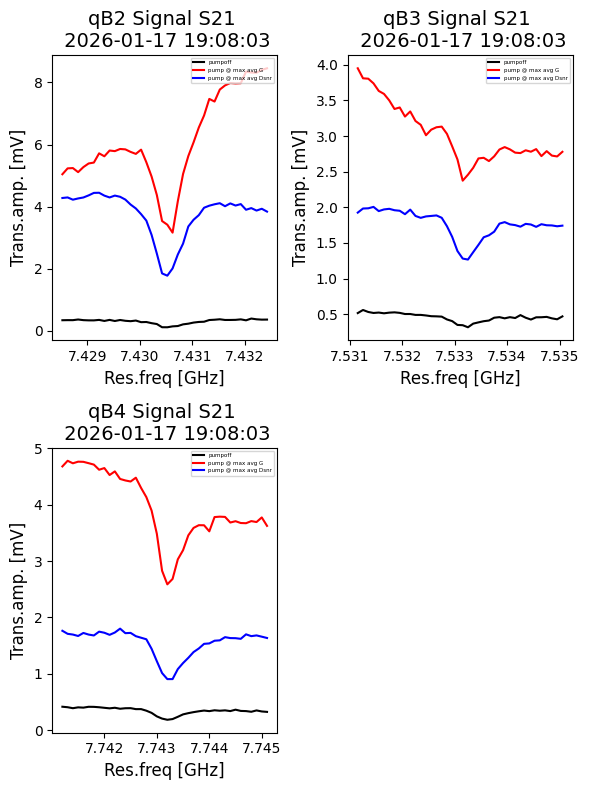

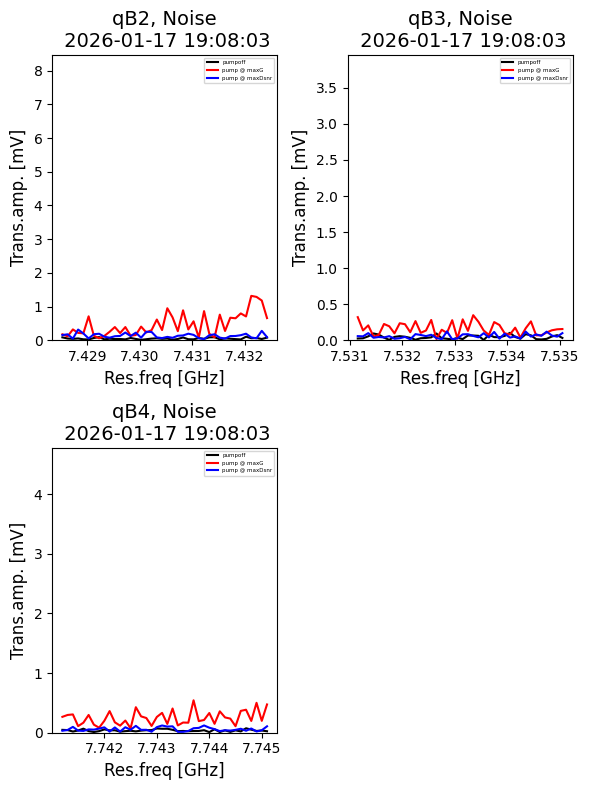

max Avg dSNR(12.7dB) 
 at fp=8.243GHz,Pp=-80.63,Pamp=0.208 
 2026-01-17 19:08:03 
 40*40*120*30


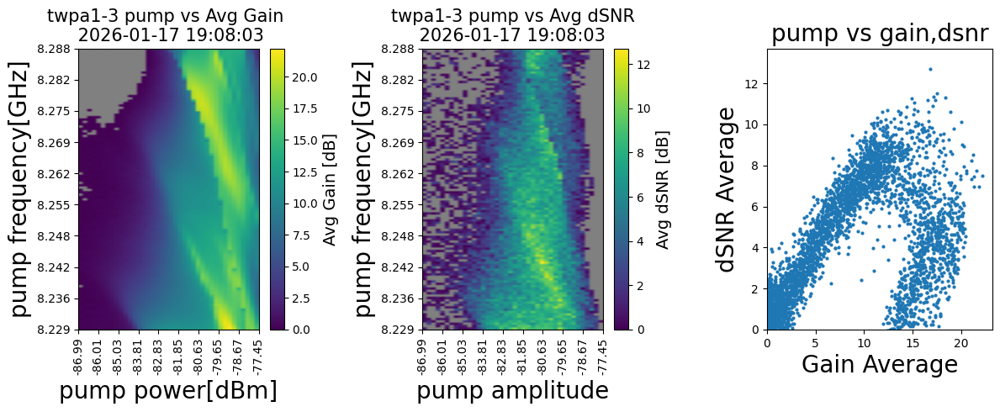

Optimized ap=0.20801,fp=8.243GHz 
qB2:dSNR:16.9dB, gain:21.88dB
qB3:dSNR:9.58dB, gain:11.68dB
qB4:dSNR:9.37dB, gain:13.19dB


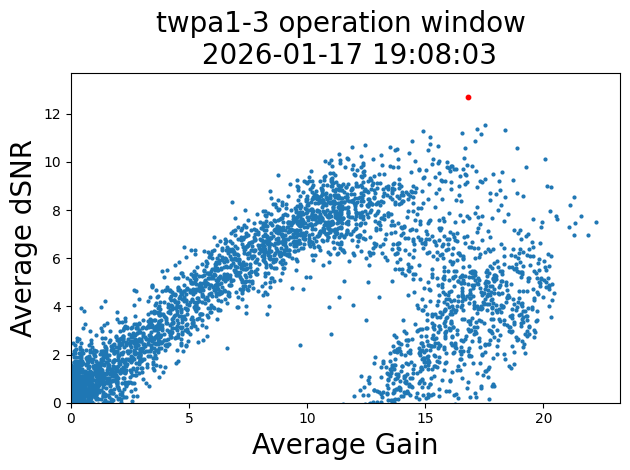

In [ ]:
time_sec = 1e-9 * 12 * n_avg * len(daps) * len(dfps) * len(dfs) * (
    machine.qubits[twpas[0].qubits[0]].resonator.operations["readout"].length +
    machine.qubits[twpas[0].qubits[0]].resonator.depletion_time
)
print(f"calibration time = {np.round(time_sec, 3)} sec")
pump_frequency=machine.twpas[twpa_].pump.LO_frequency+machine.twpas[twpa_].pump.intermediate_frequency+dfps
pump_power=opxoutput(full_scale_power_dbm,daps)+node.parameters.pumpline_attenuation
pump_power[np.isneginf(pump_power)]=0
indices=np.linspace(0, len(pump_frequency)-1,10, dtype=int)
selected_frequencies=np.round(pump_frequency[indices]*1e-9,3)
ytick_pos = np.linspace(0, len(dfps)-1, len(selected_frequencies))
indices_=np.linspace(0, len(pump_power)-1,10, dtype=int)
selected_powers=np.round(pump_power[indices_],2)
xtick_pos = np.linspace(0, len(daps)-1, len(selected_powers))
##---------------------------- SIGNAL S21 PLOT -----------------------------------------------
ncols = 2
nrows = math.ceil(len(qubits) / ncols)
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8)) 
axes = axes.flatten() 
for i, ax in enumerate(axes):
    if i < len(qubits):  # only plot existing qubits
        ax.plot(RF_freq[i]*1e-9, ds.IQ_abs_signal.values[i][0][0], label='pumpoff',color='black') #[0][0] arbitrary n_avg number of averaged S21 data
        ax.plot(RF_freq[i]*1e-9,ds_.IQ_abs_signal.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]], label='pump @ max avg G',color='red')
        ax.plot(RF_freq[i]*1e-9, ds_.IQ_abs_signal.values[i][pumpATmaxDSNR[1][0]][pumpATmaxDSNR[1][1]], label='pump @ max avg Dsnr',color='blue')
        ax.set_title(f'{qubits[i].name} Signal S21 \n {date_time}', fontsize=14)
        ax.set_xlabel('Res.freq [GHz]', fontsize=12)
        ax.set_ylabel('Trans.amp. [mV]', fontsize=12)
        ax.legend(fontsize=4, loc='upper right')
    else:
        ax.axis("off")  
plt.tight_layout()
s=plt.gcf()
plt.show()
##-----------------------------------Noise PLOT-----------------------------------------
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8)) 
axes = axes.flatten() 
for i, ax in enumerate(axes):
    if i < len(qubits):  # only plot existing qubits
        ax.plot(RF_freq[i]*1e-9, ds.IQ_abs_noise.values[i][0][0], label='pumpoff',color='black') #[0][0] arbitrary n_avg number of averaged S21 data
        ax.plot(RF_freq[i]*1e-9,ds_.IQ_abs_noise.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]], label='pump @ maxG',color='red')
        ax.plot(RF_freq[i]*1e-9, ds_.IQ_abs_noise.values[i][pumpATmaxDSNR[1][0]][pumpATmaxDSNR[1][1]], label='pump @ maxDsnr',color='blue')
        ax.set_title(f'{qubits[i].name}, Noise\n {date_time}', fontsize=14)
        ax.set_xlabel('Res.freq [GHz]', fontsize=12)
        ax.set_ylabel('Trans.amp. [mV]', fontsize=12)
        ax.set_ylim(0, max(ds_.IQ_abs_signal.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]]))
        ax.legend(fontsize=4, loc='upper right')
    else:
        ax.axis("off")  
plt.tight_layout()
n=plt.gcf()
plt.show()

### ------------------------- avggain vs pump ----------------------------------------
fig, axs = plt.subplots(1, 3, figsize=(12,5))
cmap = plt.cm.viridis.copy()
cmap.set_under('gray')
# plot gain vs pump
im0 = axs[0].imshow(average_gain, origin='lower', aspect='auto',
                    extent=[0, len(daps)-1, 0, len(dfps)-1], cmap=cmap, vmin=0)
axs[0].set_xticks(xtick_pos)
axs[0].set_xticklabels(selected_powers,rotation=90)
axs[0].set_yticks(ytick_pos)
axs[0].set_yticklabels(selected_frequencies)
axs[0].set_title(f'{twpas[0].id} pump vs Avg Gain \n {date_time}', fontsize=15)
axs[0].set_xlabel('pump power[dBm]', fontsize=20)
axs[0].set_ylabel('pump frequency[GHz]', fontsize=20)
cbar0 = fig.colorbar(im0, ax=axs[0])
cbar0.set_label('Avg Gain [dB]', fontsize=14)
print(f'max Avg dSNR({np.round(20*np.log10(np.max(np.mean(linear_dsnr,axis=0))),2)}dB) \n at fp={np.round((p_lo+p_if+pumpATmaxDSNR[0][0])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,pumpATmaxDSNR[0][1]),2)},Pamp={np.round(pumpATmaxDSNR[0][1],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

# plot avgDdSNR vs pump
im1 = axs[1].imshow(average_dsnr, origin='lower', aspect='auto',
                    extent=[0, len(daps)-1, 0, len(dfps)-1], cmap=cmap, vmin=0)
axs[1].set_xticks(xtick_pos)
axs[1].set_xticklabels(selected_powers,rotation=90)
axs[1].set_yticks(ytick_pos)
axs[1].set_yticklabels(selected_frequencies)
axs[1].set_title(f'{twpas[0].id} pump vs Avg dSNR\n {date_time} ', fontsize=15)
axs[1].set_xlabel('pump amplitude', fontsize=20)
axs[1].set_ylabel('pump frequency[GHz]', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axs[1])
cbar1.set_label('Avg dSNR [dB]', fontsize=14)
# plot gain, dsnr : TWPA SPEC
axs[2].scatter(average_gain, average_dsnr, s=4)
axs[2].set_title('pump vs gain,dsnr', fontsize=20)
axs[2].set_xlabel('Gain Average', fontsize=20)
axs[2].set_ylabel('dSNR Average', fontsize=20)
axs[2].set_xlim(0,np.max(average_gain)+1)
axs[2].set_ylim(0,np.max(average_dsnr)+1)
plt.tight_layout()
map=plt.gcf()
plt.show()

# operation window
plt.plot(figzise=(4,3))
avg_optimized_pump=optimizer(11, 6,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red')
plt.title(f'{twpas[0].id} operation window \n {date_time}', fontsize=20)
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.tight_layout()
window=plt.gcf()
plt.show()

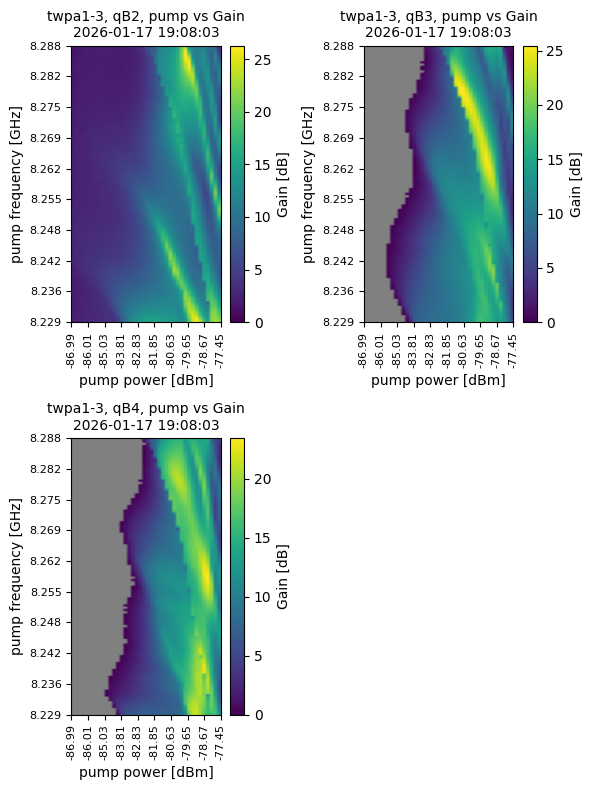

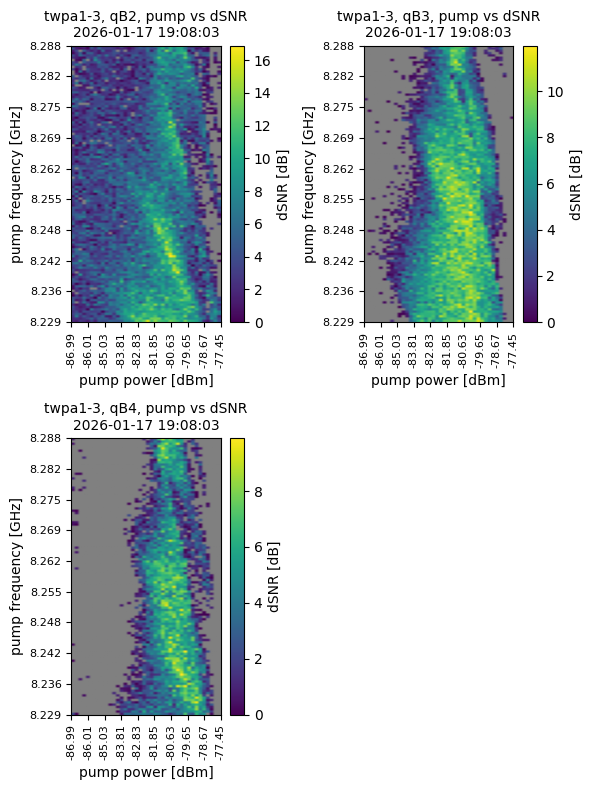

IndexError: index 3 is out of bounds for axis 0 with size 3

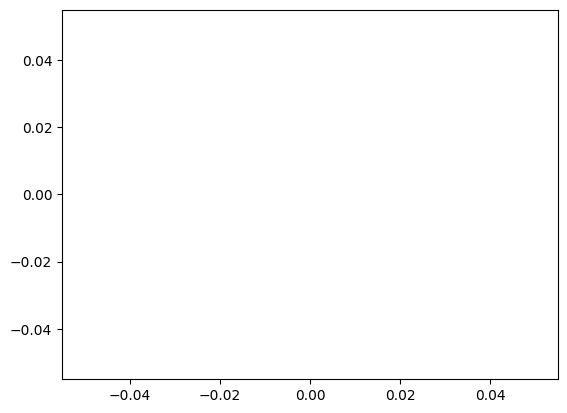

In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        label=f'{qubits[i].id}',
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',edgecolors=colors[i],linewidths=5,zorder=10,alpha=1,label=f'qB{i+1}@ Multiplexed RO Optimized')
plt.title(f'{twpas[0].id} spec per qubits\n Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

In [ ]:
""" Jeongwon Kim, Akiva, Omrie, Wei  IQCC, 250924
Sweep pump frequency and amplitude
For each pumping point, calculate Gain, SNR improvement.
Optimize pumping point for the worst SNR Qubit so that the multiplexed readout could be done faster in the given fidelity.

Prerequisites:
    - Need to know in which frequency dispersive feature of TWPA RPM resonator appears
    - Having calibrated the resonator frequency (nodes 02a, 02b and/or 02c).
    - Having calibrated the worst SNR Qubit 

* Gain is defined as the increase in the signal level.
    - twpa pump off : measure the signal response within  a 4MHz around the readout resonator
      singal_off= signal[dB] 
    - twpa pump on :  measure signal response within the same 4MHz around the readout resonator
      singal_on= signal[dB]
    => gain=signal_on-signal_off
* SNR improvement is defined 
    - twpa pump off : measure within a 4 MHz window around the readout resonator twice
      measure(amp=0) for noise level
      measure(amp=from state file) for signal level
      snr_off= signal[dB]-noise[dB]
    - twpa pump on :  measure within a 4 MHz window around the readout resonator twice
      measure(amp=0) for noise level
      measure(amp=from state file) for signal level
    => dsnr=snr_on-snr_off
"""

# %% {Imports}
from datetime import datetime, timezone, timedelta
from iqcc_calibration_tools.qualibrate_config.qualibrate.node import QualibrationNode, NodeParameters
from iqcc_calibration_tools.quam_config.components.quam_root import Quam
from iqcc_calibration_tools.quam_config.macros import qua_declaration
from iqcc_calibration_tools.quam_config.lib.qua_datasets import convert_IQ_to_V
from iqcc_calibration_tools.storage.save_utils import fetch_results_as_xarray
from iqcc_calibration_tools.analysis.twpa_utils import  * 
from qualang_tools.results import  fetching_tool
from qualang_tools.loops import from_array
from qualang_tools.multi_user import qm_session
from qualang_tools.units import unit
from qm import SimulationConfig
from qm.qua import *
from typing import Literal, Optional, List
import matplotlib.pyplot as plt
import numpy as np
import math
from iqcc_calibration_tools.quam_config.lib.qua_datasets import opxoutput

In [ ]:
class Parameters(NodeParameters):
    twpas: Optional[List[str]] = ['twpa1-3']
    num_averages: int =30
    amp_min: float =  0.1
    amp_max: float =  0.3
    points : int = 40
    frequency_span_in_mhz: float = 4
    frequency_step_in_mhz: float = 0.1
    p_frequency_span_in_mhz: float = 60
    p_frequency_step_in_mhz: float =0.5
    flux_point_joint_or_independent: Literal["joint", "independent"] = "joint"
    simulate: bool = False
    simulation_duration_ns: int = 4000
    timeout: int = 300
    load_data_id: Optional[int] = None
    pumpline_attenuation: int = -50-5 #(-50: fridge atten(-30)+directional coupler(-20))  
    signalline_attenuation : int = -60-5 #-60dB : fridge atten
node = QualibrationNode(name="00a_twpa1_3_calibration_MTPLX_RO", parameters=Parameters())
date_time = datetime.now(timezone(timedelta(hours=2))).strftime("%Y-%m-%d %H:%M:%S")
node.results["date"]={"date":date_time}

2026-01-17 18:15:17,227 - qualibrate - INFO - Creating node 00a_twpa1_3_calibration_MTPLX_RO


In [ ]:
# Class containing tools to help handling units and conversions.
u = unit(coerce_to_integer=True)
# Instantiate the QuAM class from the state file
machine = Quam.load()

# Get the relevant QuAM components
twpas = [machine.twpas[t] for t in node.parameters.twpas]
twpa_=node.parameters.twpas[0]
qubits = [machine.qubits[machine.twpas[twpa_].qubits[i]] for i in range(len(machine.twpas[twpa_].qubits))]
resonators = [machine.qubits[machine.twpas[twpa_].qubits[i]].resonator for i in range(len(machine.twpas[twpa_].qubits))]

# Generate the OPX and Octave configurations
config = machine.generate_config()
# Open Communication with the QOP
if node.parameters.load_data_id is None:
    qmm = machine.connect()

c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\quam\components\channels.py:636: UserWarning: The 'thread' element argument is deprecated from qm.qua >= 1.2.2. Use 'core' instead.
  warnings.warn(


In [ ]:
readout_power=[np.round(opxoutput(qubits[i].resonator.opx_output.full_scale_power_dbm,qubits[i].resonator.operations["readout"].amplitude)+node.parameters.signalline_attenuation,2) for i in range(len(qubits))]
readout_length=[qubits[i].resonator.operations["readout"].length for i in range(len(qubits))]
for i in range(len(readout_power)):
    print(f"{qubits[i].name}: readout power @ resonator={readout_power[i]}dBm, readout length={readout_length[i]}, Aro={qubits[i].resonator.operations['readout'].amplitude} ")

qB1: readout power @ resonator=-104.76dBm, readout length=1500, Aro=0.023 
qB2: readout power @ resonator=-102.45dBm, readout length=1500, Aro=0.03 
qB3: readout power @ resonator=-98.93dBm, readout length=1500, Aro=0.045 
qB4: readout power @ resonator=-94.49dBm, readout length=1500, Aro=0.075 
qB5: readout power @ resonator=-101.11dBm, readout length=1500, Aro=0.035 


In [ ]:
n_avg = node.parameters.num_averages  
# The frequency sweep around the resonator resonance frequency
span = node.parameters.frequency_span_in_mhz * u.MHz
step = node.parameters.frequency_step_in_mhz * u.MHz
dfs = np.arange(-span / 2, +span / 2, step)
# pump amp, frequency sweep
full_scale_power_dbm=twpas[0].pump.opx_output.full_scale_power_dbm
amp_max = node.parameters.amp_max
amp_min = node.parameters.amp_min
amp_step = int((opxoutput(full_scale_power_dbm, amp_max)-(opxoutput(full_scale_power_dbm, amp_min)))/0.2)
daps = np.logspace(np.log10(amp_min), np.log10(amp_max), node.parameters.points)

span_p = node.parameters.p_frequency_span_in_mhz * u.MHz
step_p = node.parameters.p_frequency_step_in_mhz * u.MHz
dfps = np.arange(-span_p / 2, +span_p / 2, step_p)
pump_duration = (10*len(dfs)*(machine.qubits[twpas[0].qubits[0]].resonator.operations["readout"].length+machine.qubits[twpas[0].qubits[0]].resonator.depletion_time))/4#(n_avg*len(dfs)*(machine.qubits[twpas[0].qubits[0]].resonator.operations["readout"].length+machine.qubits[twpas[0].qubits[0]].resonator.depletion_time))/4
with program() as twpa_pump_off:    
    I, I_st, Q, Q_st,n,n_st = qua_declaration(num_qubits=len(qubits))
    I_, I_st_, Q_, Q_st_,n_,n_st_ = qua_declaration(num_qubits=len(qubits))
    dp = declare(int)  # QUA variable for the pump frequency
    da = declare(float)# QUA variable for the pump amplitude
    df = declare(int)  # QUA variable for the readout frequency
    for qubit in qubits:
        machine.set_all_fluxes(flux_point="joint", target=qubit)
# TWPA off
    with for_(n, 0, n < n_avg, n + 1):  
        save(n, n_st)
        with for_(*from_array(dp, dfps)):  
            with for_each_(da, daps): 
# measure readout responses around readout resonators without pump
                with for_(*from_array(df, dfs)):
                    for i, rr in enumerate(resonators):
                        # Update the resonator frequencies for all resonators
                        update_frequency(rr.name, df + rr.intermediate_frequency)
                        # Measure the resonator
                        rr.measure("readout",amplitude_scale=0, qua_vars=(I[i], Q[i]))
                        # wait for the resonator to relax
                        rr.wait(rr.depletion_time * u.ns)
                        # save data
                        save(I[i], I_st[i])
                        save(Q[i], Q_st[i]) 
                #align() why it doesnt work if i add this 10.12
                with for_(*from_array(df, dfs)):
                    for i, rr in enumerate(resonators):
                        # Update the resonator frequencies for all resonators
                        update_frequency(rr.name, df + rr.intermediate_frequency)
                        # Measure the resonator
                        rr.measure("readout",  qua_vars=(I_[i], Q_[i]))
                        # wait for the resonator to relax
                        rr.wait(rr.depletion_time * u.ns)
                        # save data
                        save(I_[i], I_st_[i])
                        save(Q_[i], Q_st_[i])
                align()  
    with stream_processing():
        n_st.save("n")
        for i in range(len(qubits)):
            I_st[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"I{i + 1}")
            Q_st[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"Q{i + 1}")
            I_st_[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"I_{i + 1}")
            Q_st_[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"Q_{i + 1}") 
### TWPA on
with program() as twpa_pump_on:    
    I, I_st, Q, Q_st,n,n_st = qua_declaration(num_qubits=len(qubits))
    I_, I_st_, Q_, Q_st_,n_,n_st_ = qua_declaration(num_qubits=len(qubits))
    dp = declare(int)  # QUA variable for the pump frequency
    da = declare(float)# QUA variable for the pump amplitude
    df = declare(int)  # QUA variable for the readout frequency
    for qubit in qubits:
        machine.set_all_fluxes(flux_point="joint", target=qubit)
    with for_(n, 0, n < n_avg, n + 1):  
        save(n, n_st)
        with for_(*from_array(dp, dfps)):  
            update_frequency(twpas[0].pump_.name, dp + twpas[0].pump_.intermediate_frequency)
            with for_each_(da, daps):  
                twpas[0].pump_.play('pump_', amplitude_scale=da, duration=pump_duration)
                wait(25) #100/4 wait 100ns(change on 30/11) 1000/4 wait 1us for pump to settle before readout
# measure readout responses around readout resonators with pump
                with for_(*from_array(df, dfs)):
                    for i, rr in enumerate(resonators):
                        # Update the resonator frequencies for all resonators
                        update_frequency(rr.name, df + rr.intermediate_frequency)
                        # Measure the resonator, amp=0 -> see the noise level
                        rr.measure("readout",amplitude_scale=0, qua_vars=(I[i], Q[i]))
                        # wait for the resonator to relax
                        rr.wait(rr.depletion_time * u.ns)
                        # save data
                        save(I[i], I_st[i])
                        save(Q[i], Q_st[i]) 
                #align() doesnt work
                with for_(*from_array(df, dfs)):
                    for i, rr in enumerate(resonators):
                        # Update the resonator frequencies for all resonators
                        update_frequency(rr.name, df + rr.intermediate_frequency)
                        # Measure the resonator, amp, see the signal level
                        rr.measure("readout", qua_vars=(I_[i], Q_[i]))
                        # wait for the resonator to relax
                        rr.wait(rr.depletion_time * u.ns)
                        # save data
                        save(I_[i], I_st_[i])
                        save(Q_[i], Q_st_[i])
                align()  
    with stream_processing():
        n_st.save("n")
        for i in range(len(qubits)):
            I_st[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"I{i + 1}")
            Q_st[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"Q{i + 1}")
            I_st_[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"I_{i + 1}")
            Q_st_[i].buffer(len(dfs)).buffer(len(daps)).buffer(len(dfps)).average().save(f"Q_{i + 1}") 

In [ ]:
import requests
if node.parameters.simulate:
    # Simulates the QUA program for the specified duration
    simulation_config = SimulationConfig(duration=node.parameters.simulation_duration_ns * 4)  # In clock cycles = 4ns
    job = qmm.simulate(config, twpa_pump_off, simulation_config)
    
    # Get the simulated samples and plot them for all controllers
    samples = job.get_simulated_samples()
    fig, ax = plt.subplots(nrows=len(samples.keys()), sharex=True)
    for i, con in enumerate(samples.keys()):
        plt.subplot(len(samples.keys()),1,i+1)
        samples[con].plot()
        plt.title(f'{con}-Pump, Readout pulse simulation')
    plt.tight_layout()
    # Save the figure
    node.results = {"figure": plt.gcf()}
    node.machine = machine
    node.save()
elif node.parameters.load_data_id is None:
    date_time = datetime.now(timezone(timedelta(hours=3))).strftime("%Y-%m-%d %H:%M:%S")
    with qm_session(qmm, config, timeout=node.parameters.timeout) as qm:
        job = qm.execute(twpa_pump_off)
        results = fetching_tool(job, ["n"], mode="live")
        while results.is_processing():
            n = results.fetch_all()[0]
    with qm_session(qmm, config, timeout=node.parameters.timeout) as qm:
        job_ = qm.execute(twpa_pump_on)
        results_ = fetching_tool(job_, ["n"], mode="live")
        while results_.is_processing():
            n_ = results_.fetch_all()[0]

2026-01-17 18:15:20,521 - qm - INFO     - Opening QM
2026-01-17 18:15:20,521 - qm - WARNING  - Could not generate a loaded config. Maybe there is no `QuantumMachinesManager` instance?
[18:15:23] QUA program submitted to arbel (id = 359ce704-8dc0-4583-b7a3-4d521db12c35)              ]8;id=901243;file://c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\iqcc_cloud_client\computers.py\computers.py]8;;\:]8;id=31976;file://c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\iqcc_cloud_client\computers.py#324\324]8;;\
[18:15:24] Execution started                                                                       ]8;id=620720;file://c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\iqcc_cloud_client\computers.py\computers.py]8;;\:]8;id=889878;file://c:\Users\KimJeongwon\iqcc-calibration-1\.venv\Lib\site-packages\iqcc_cloud_client\computers.py#344\344]8;;\
[18:16:59] Execution finished                                                    

In [ ]:
#data for pump off
ds = fetch_results_as_xarray(job.result_handles, qubits, {"freq": dfs, "pump_amp": daps, "pump_freq" : dfps})
# Convert IQ data into volts
ds = convert_IQ_to_V(ds, qubits)
# Derive the amplitude IQ_abs = sqrt(I**2 + Q**2)
ds = ds.assign({"IQ_abs_noise": 1e3*np.sqrt(ds["I"] ** 2 + ds["Q"] ** 2)})
ds = ds.assign({"IQ_abs_signal": 1e3*np.sqrt(ds["I_"] ** 2 + ds["Q_"] ** 2)})
pumpoff_snr = snr(ds, qubits, dfps, daps)

#data for pump on
ds_ = fetch_results_as_xarray(job_.result_handles, qubits, {"freq": dfs, "pump_amp": daps, "pump_freq" : dfps})
# Convert IQ data into volts
ds_ = convert_IQ_to_V(ds_, qubits)
# Derive the amplitude IQ_abs = sqrt(I**2 + Q**2)
ds_ = ds_.assign({"IQ_abs_noise": 1e3*np.sqrt(ds_["I"] ** 2 + ds_["Q"] ** 2)})
ds_ = ds_.assign({"IQ_abs_signal": 1e3*np.sqrt(ds_["I_"] ** 2 + ds_["Q_"] ** 2)})
pumpon_snr = snr(ds_, qubits, dfps, daps)

In [ ]:
# SNR improvement & Gain
RF_freq = np.array([dfs + q.resonator.RF_frequency for q in qubits])
dsnr = pumpon_snr-pumpoff_snr
Gain = gain(ds, ds_, qubits, dfps, daps)
linear_gain = 10**(Gain/20)
linear_dsnr = 10**(dsnr/20)
average_gain=20*np.log10(np.mean(linear_gain,axis=0))
average_dsnr=20*np.log10(np.mean(linear_dsnr,axis=0))
p_lo=twpas[0].pump.LO_frequency
p_if=twpas[0].pump.intermediate_frequency
# pump at max avg_gain
pumpATmaxG=pump_maxgain(Gain, dfps, daps)
print(f'max Avg Gain({np.round(20*np.log10(np.max(np.mean(linear_gain,axis=0))))}dB) at fp={np.round((p_lo+p_if+pumpATmaxG[0][0])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,pumpATmaxG[0][1]),2)},Pamp={np.round(pumpATmaxG[0][1],3)}')
# pump at max dSNR
pumpATmaxDSNR=pump_maxdsnr(dsnr, dfps, daps)
maxDSNR_point={'fp':np.round((p_lo+p_if+pumpATmaxDSNR[0][0]),3), 
                 'Pp': node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,pumpATmaxDSNR[0][1]),
                 'Pamp': np.round(pumpATmaxDSNR[0][1],3)}
node.results["maxDSNR point"] = maxDSNR_point

max Avg Gain(21.0dB) at fp=8.23GHz,Pp=-79.16,Pamp=0.246


calibration time = 311.04 sec


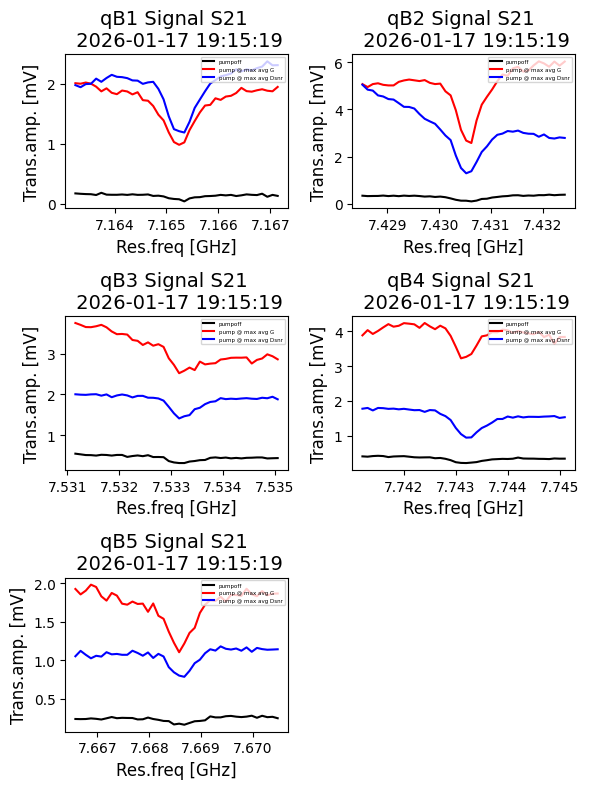

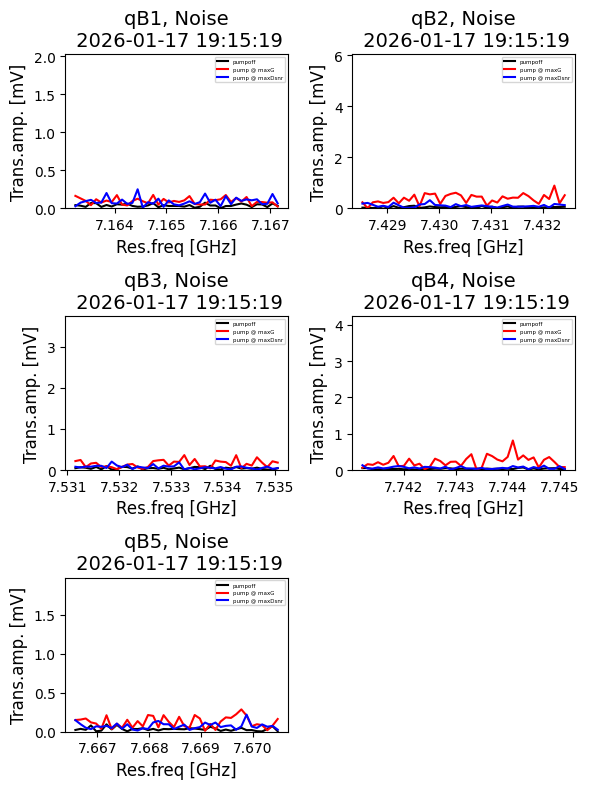

max Avg dSNR(14.14dB) 
 at fp=8.239GHz,Pp=-80.38,Pamp=0.214 
 2026-01-17 19:15:19 
 40*40*120*30


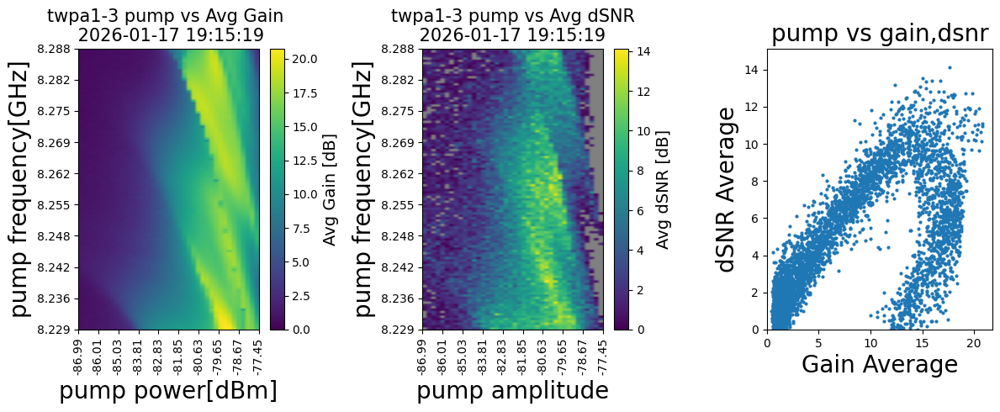

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


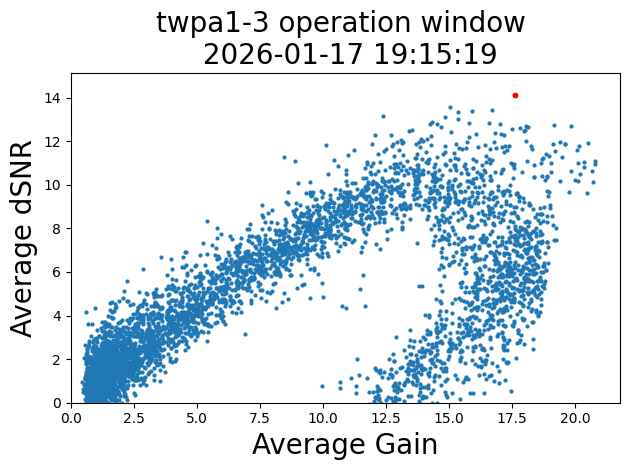

In [ ]:
time_sec = 1e-9 * 12 * n_avg * len(daps) * len(dfps) * len(dfs) * (
    machine.qubits[twpas[0].qubits[0]].resonator.operations["readout"].length +
    machine.qubits[twpas[0].qubits[0]].resonator.depletion_time
)
print(f"calibration time = {np.round(time_sec, 3)} sec")
pump_frequency=machine.twpas[twpa_].pump.LO_frequency+machine.twpas[twpa_].pump.intermediate_frequency+dfps
pump_power=opxoutput(full_scale_power_dbm,daps)+node.parameters.pumpline_attenuation
pump_power[np.isneginf(pump_power)]=0
indices=np.linspace(0, len(pump_frequency)-1,10, dtype=int)
selected_frequencies=np.round(pump_frequency[indices]*1e-9,3)
ytick_pos = np.linspace(0, len(dfps)-1, len(selected_frequencies))
indices_=np.linspace(0, len(pump_power)-1,10, dtype=int)
selected_powers=np.round(pump_power[indices_],2)
xtick_pos = np.linspace(0, len(daps)-1, len(selected_powers))
##---------------------------- SIGNAL S21 PLOT -----------------------------------------------
ncols = 2
nrows = math.ceil(len(qubits) / ncols)
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8)) 
axes = axes.flatten() 
for i, ax in enumerate(axes):
    if i < len(qubits):  # only plot existing qubits
        ax.plot(RF_freq[i]*1e-9, ds.IQ_abs_signal.values[i][0][0], label='pumpoff',color='black') #[0][0] arbitrary n_avg number of averaged S21 data
        ax.plot(RF_freq[i]*1e-9,ds_.IQ_abs_signal.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]], label='pump @ max avg G',color='red')
        ax.plot(RF_freq[i]*1e-9, ds_.IQ_abs_signal.values[i][pumpATmaxDSNR[1][0]][pumpATmaxDSNR[1][1]], label='pump @ max avg Dsnr',color='blue')
        ax.set_title(f'{qubits[i].name} Signal S21 \n {date_time}', fontsize=14)
        ax.set_xlabel('Res.freq [GHz]', fontsize=12)
        ax.set_ylabel('Trans.amp. [mV]', fontsize=12)
        ax.legend(fontsize=4, loc='upper right')
    else:
        ax.axis("off")  
plt.tight_layout()
s=plt.gcf()
plt.show()
##-----------------------------------Noise PLOT-----------------------------------------
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8)) 
axes = axes.flatten() 
for i, ax in enumerate(axes):
    if i < len(qubits):  # only plot existing qubits
        ax.plot(RF_freq[i]*1e-9, ds.IQ_abs_noise.values[i][0][0], label='pumpoff',color='black') #[0][0] arbitrary n_avg number of averaged S21 data
        ax.plot(RF_freq[i]*1e-9,ds_.IQ_abs_noise.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]], label='pump @ maxG',color='red')
        ax.plot(RF_freq[i]*1e-9, ds_.IQ_abs_noise.values[i][pumpATmaxDSNR[1][0]][pumpATmaxDSNR[1][1]], label='pump @ maxDsnr',color='blue')
        ax.set_title(f'{qubits[i].name}, Noise\n {date_time}', fontsize=14)
        ax.set_xlabel('Res.freq [GHz]', fontsize=12)
        ax.set_ylabel('Trans.amp. [mV]', fontsize=12)
        ax.set_ylim(0, max(ds_.IQ_abs_signal.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]]))
        ax.legend(fontsize=4, loc='upper right')
    else:
        ax.axis("off")  
plt.tight_layout()
n=plt.gcf()
plt.show()

### ------------------------- avggain vs pump ----------------------------------------
fig, axs = plt.subplots(1, 3, figsize=(12,5))
cmap = plt.cm.viridis.copy()
cmap.set_under('gray')
# plot gain vs pump
im0 = axs[0].imshow(average_gain, origin='lower', aspect='auto',
                    extent=[0, len(daps)-1, 0, len(dfps)-1], cmap=cmap, vmin=0)
axs[0].set_xticks(xtick_pos)
axs[0].set_xticklabels(selected_powers,rotation=90)
axs[0].set_yticks(ytick_pos)
axs[0].set_yticklabels(selected_frequencies)
axs[0].set_title(f'{twpas[0].id} pump vs Avg Gain \n {date_time}', fontsize=15)
axs[0].set_xlabel('pump power[dBm]', fontsize=20)
axs[0].set_ylabel('pump frequency[GHz]', fontsize=20)
cbar0 = fig.colorbar(im0, ax=axs[0])
cbar0.set_label('Avg Gain [dB]', fontsize=14)
print(f'max Avg dSNR({np.round(20*np.log10(np.max(np.mean(linear_dsnr,axis=0))),2)}dB) \n at fp={np.round((p_lo+p_if+pumpATmaxDSNR[0][0])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,pumpATmaxDSNR[0][1]),2)},Pamp={np.round(pumpATmaxDSNR[0][1],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

# plot avgDdSNR vs pump
im1 = axs[1].imshow(average_dsnr, origin='lower', aspect='auto',
                    extent=[0, len(daps)-1, 0, len(dfps)-1], cmap=cmap, vmin=0)
axs[1].set_xticks(xtick_pos)
axs[1].set_xticklabels(selected_powers,rotation=90)
axs[1].set_yticks(ytick_pos)
axs[1].set_yticklabels(selected_frequencies)
axs[1].set_title(f'{twpas[0].id} pump vs Avg dSNR\n {date_time} ', fontsize=15)
axs[1].set_xlabel('pump amplitude', fontsize=20)
axs[1].set_ylabel('pump frequency[GHz]', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axs[1])
cbar1.set_label('Avg dSNR [dB]', fontsize=14)
# plot gain, dsnr : TWPA SPEC
axs[2].scatter(average_gain, average_dsnr, s=4)
axs[2].set_title('pump vs gain,dsnr', fontsize=20)
axs[2].set_xlabel('Gain Average', fontsize=20)
axs[2].set_ylabel('dSNR Average', fontsize=20)
axs[2].set_xlim(0,np.max(average_gain)+1)
axs[2].set_ylim(0,np.max(average_dsnr)+1)
plt.tight_layout()
map=plt.gcf()
plt.show()

# operation window
plt.plot(figzise=(4,3))
avg_optimized_pump=optimizer(11, 6,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red')
plt.title(f'{twpas[0].id} operation window \n {date_time}', fontsize=20)
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.tight_layout()
window=plt.gcf()
plt.show()

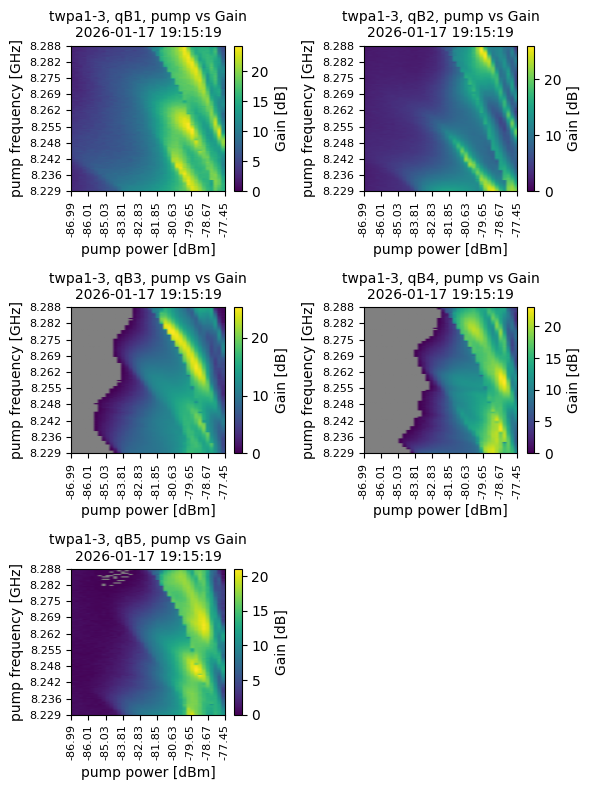

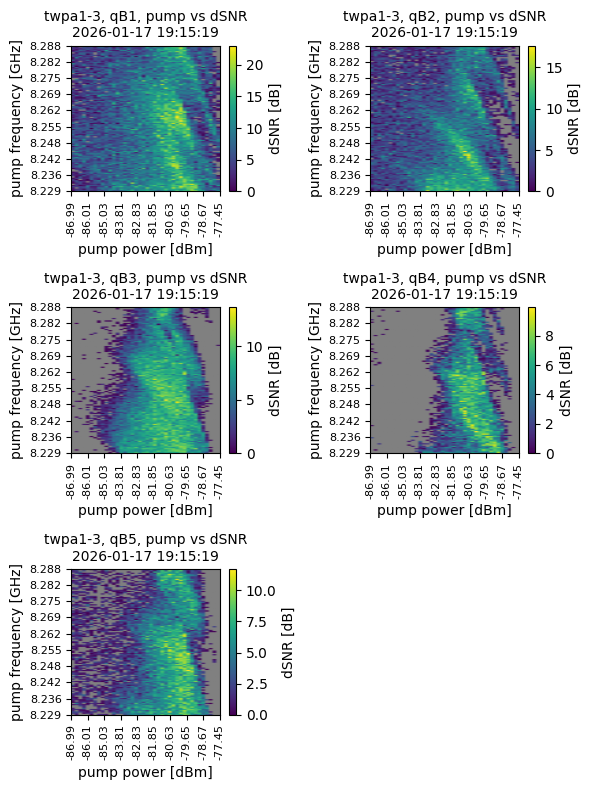

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


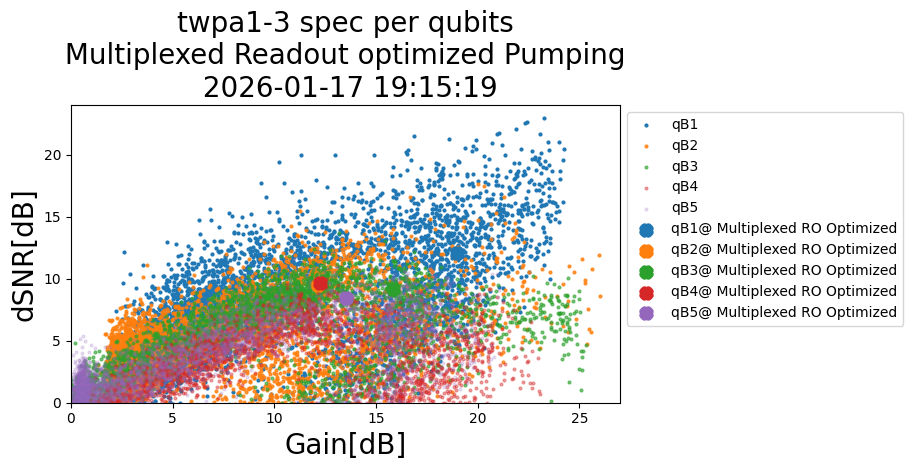

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        label=f'{qubits[i].id}',
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',edgecolors=colors[i],linewidths=5,zorder=10,alpha=1,label=f'qB{i+1}@ Multiplexed RO Optimized')
plt.title(f'{twpas[0].id} spec per qubits\n Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

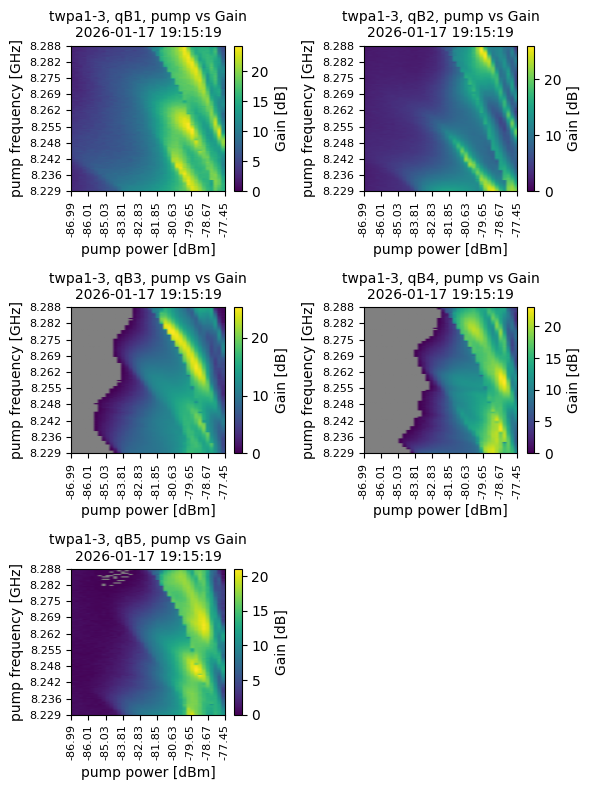

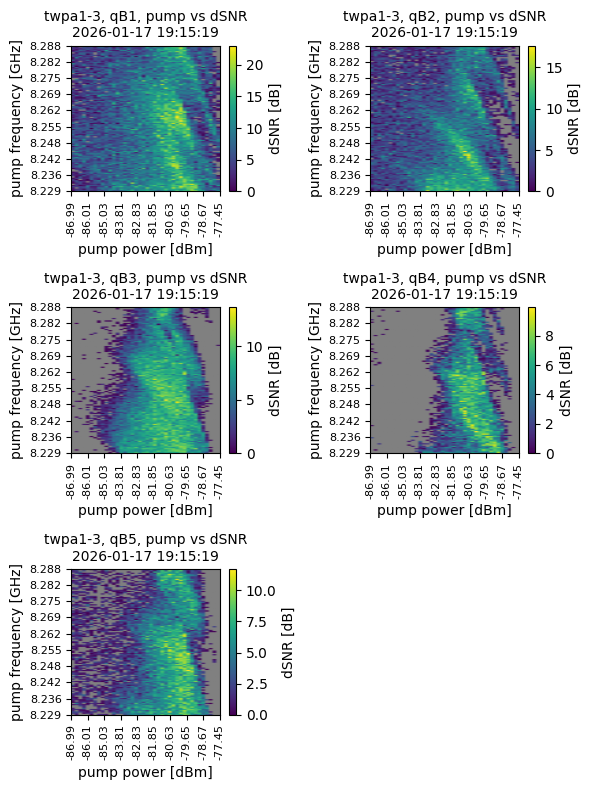

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


<ipython-input-21-ba0325e9efc9>:60: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',c=colors[i],edgecolors='black',linewidths=5,zorder=10,alpha=1,label=f'qB{i+1}@ Multiplexed RO Optimized')


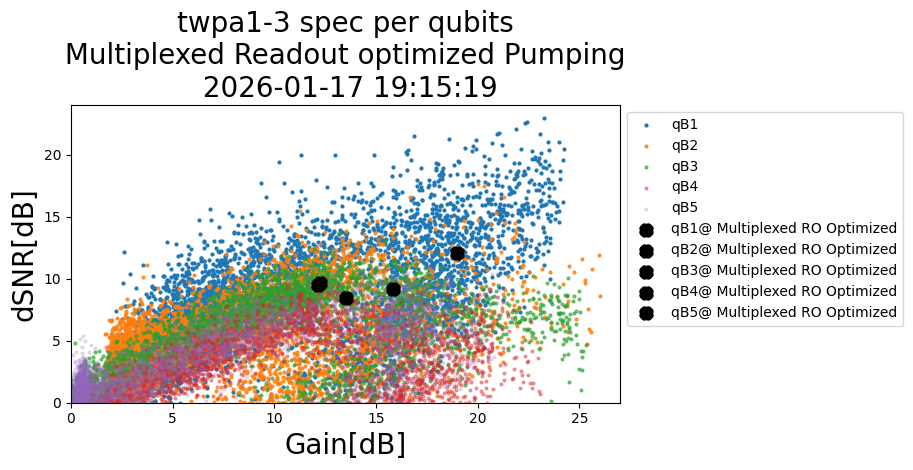

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        label=f'{qubits[i].id}',
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',c=colors[i],edgecolors='black',linewidths=5,zorder=10,alpha=1,label=f'qB{i+1}@ Multiplexed RO Optimized')
plt.title(f'{twpas[0].id} spec per qubits\n Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

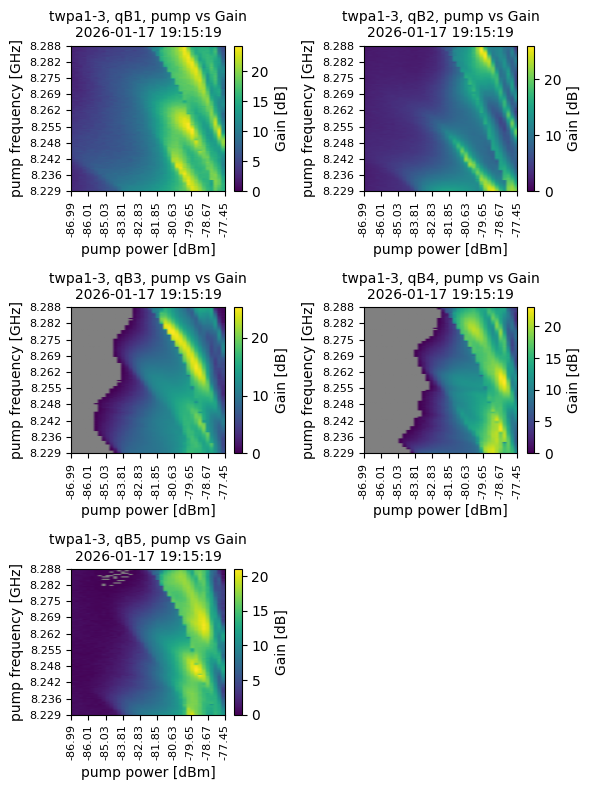

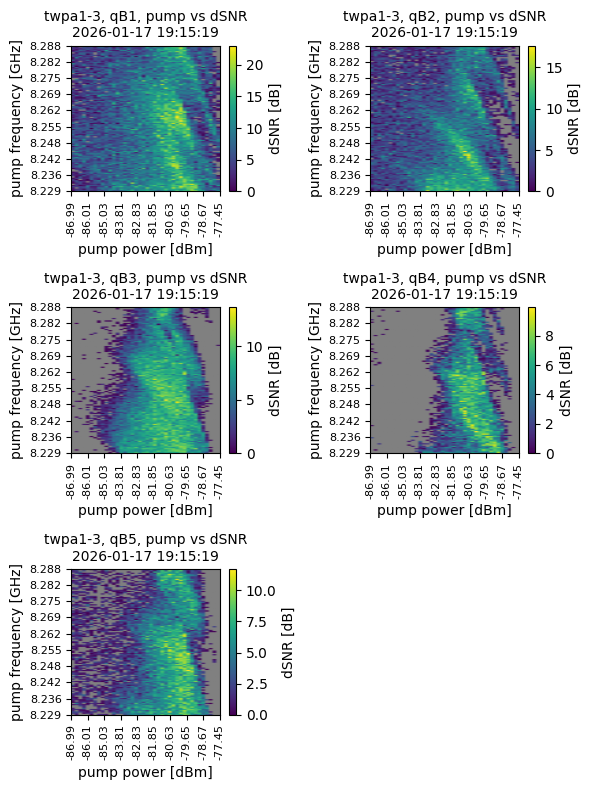

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


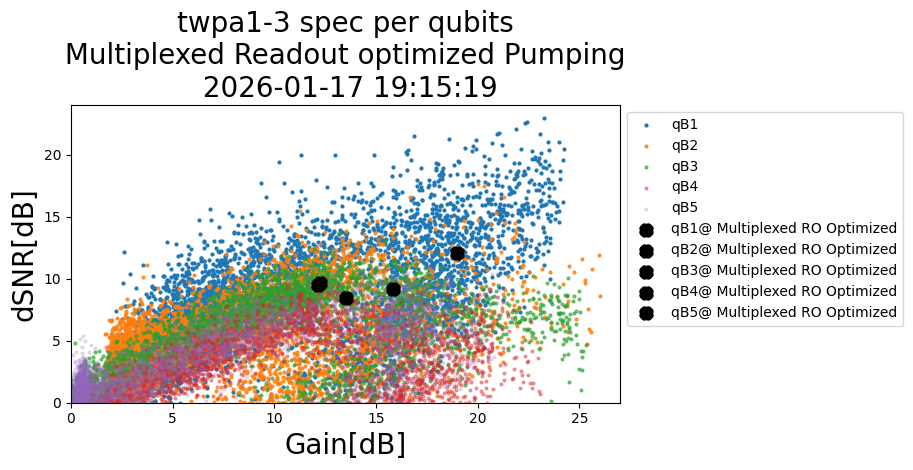

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        label=f'{qubits[i].id}',
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',facecolors=colors[i],edgecolors='black',linewidths=5,zorder=10,alpha=1,label=f'qB{i+1}@ Multiplexed RO Optimized')
plt.title(f'{twpas[0].id} spec per qubits\n Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

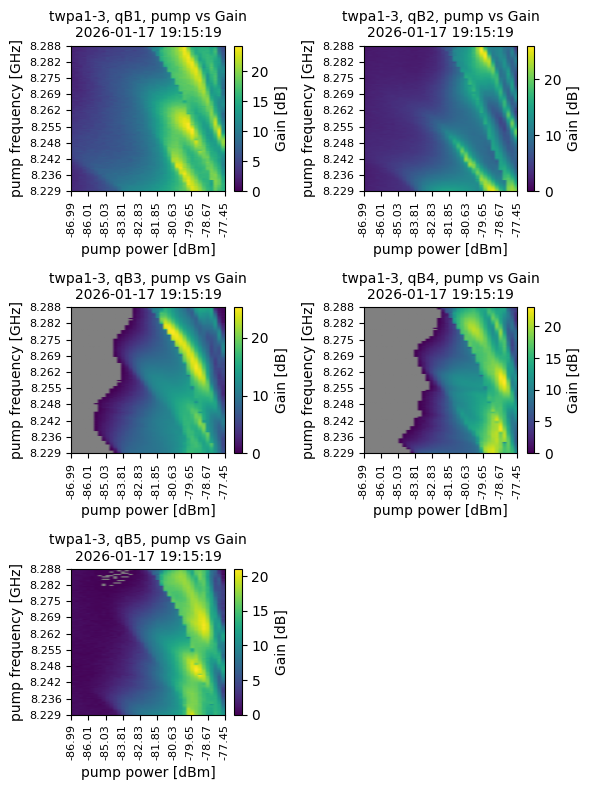

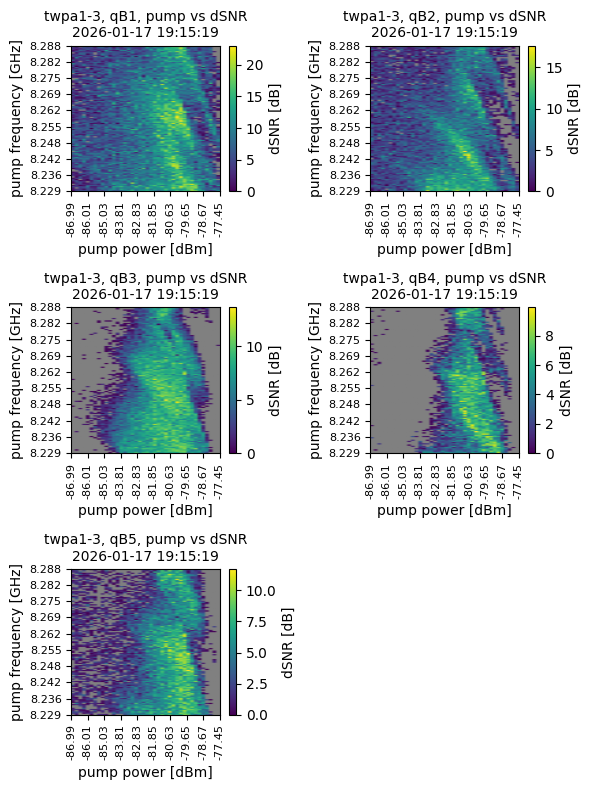

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


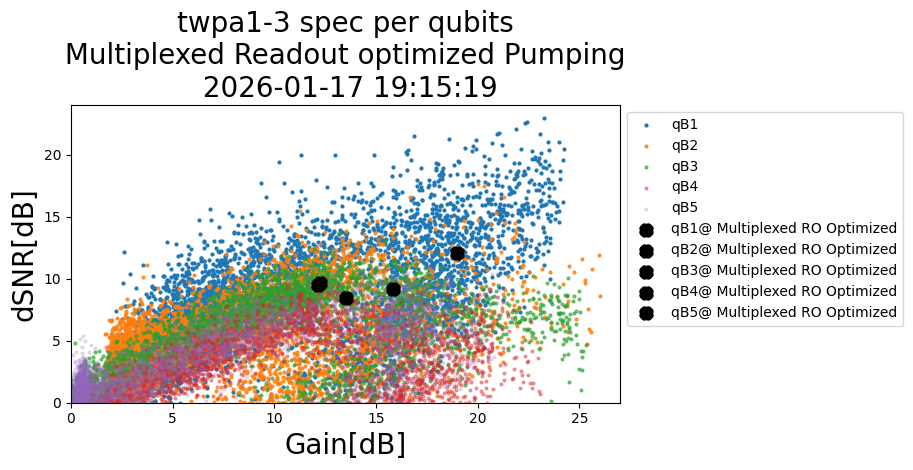

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        label=f'{qubits[i].id}',
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',facecolors=colors[i],edgecolors='black',linewidths=5,zorder=10,alpha=1,label=f'qB{i+1}@ Multiplexed RO Optimized')
plt.title(f'{twpas[0].id} spec per qubits\n Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

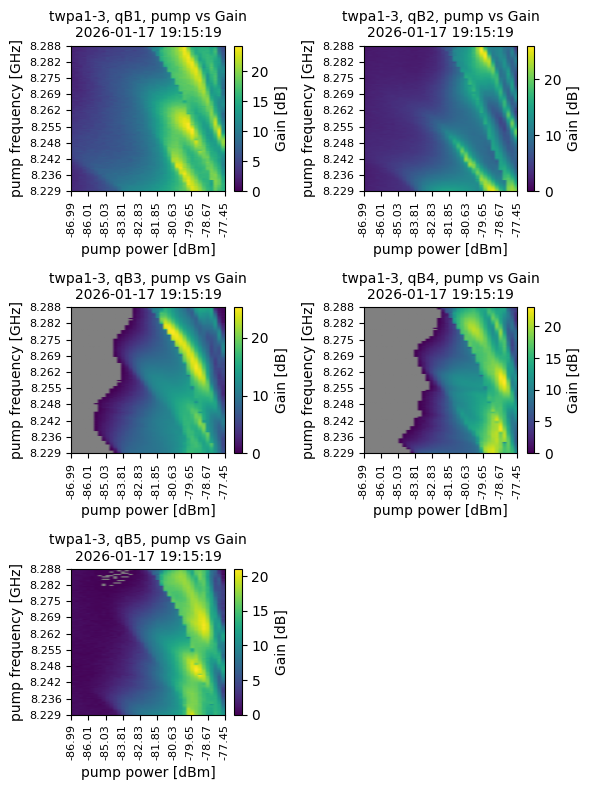

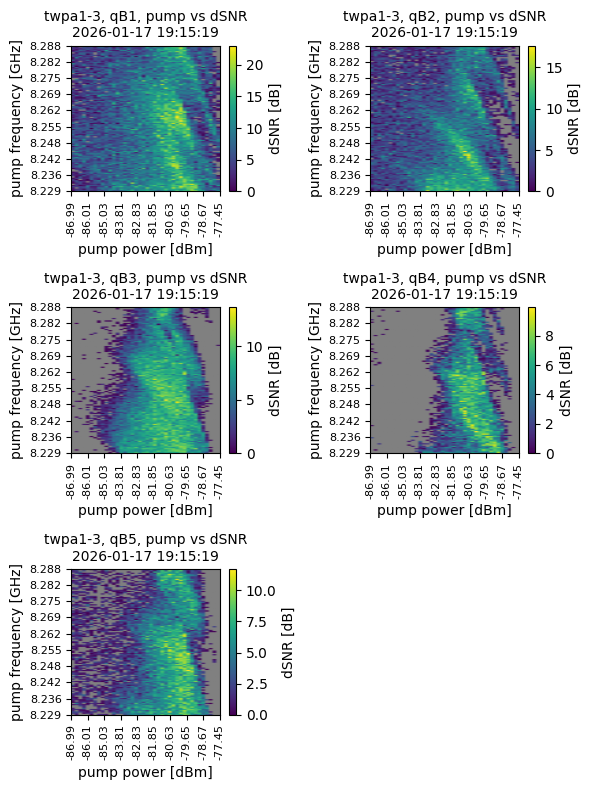

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


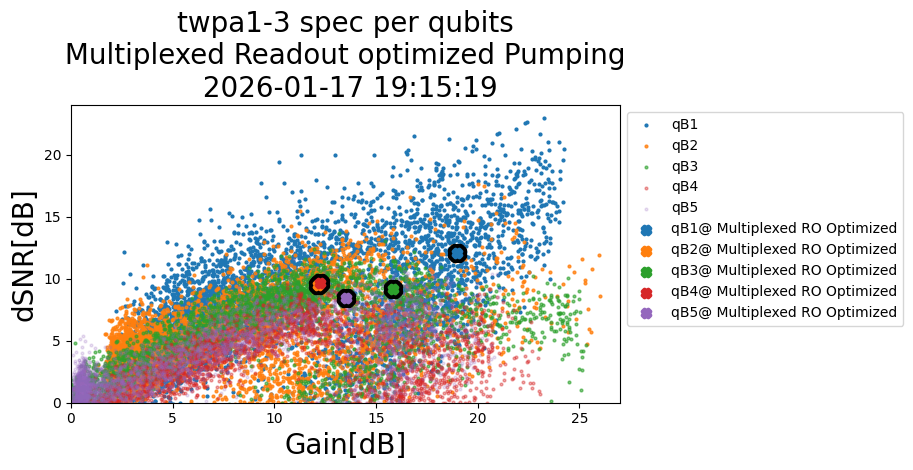

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        label=f'{qubits[i].id}',
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}@ Multiplexed RO Optimized')
plt.title(f'{twpas[0].id} spec per qubits\n Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

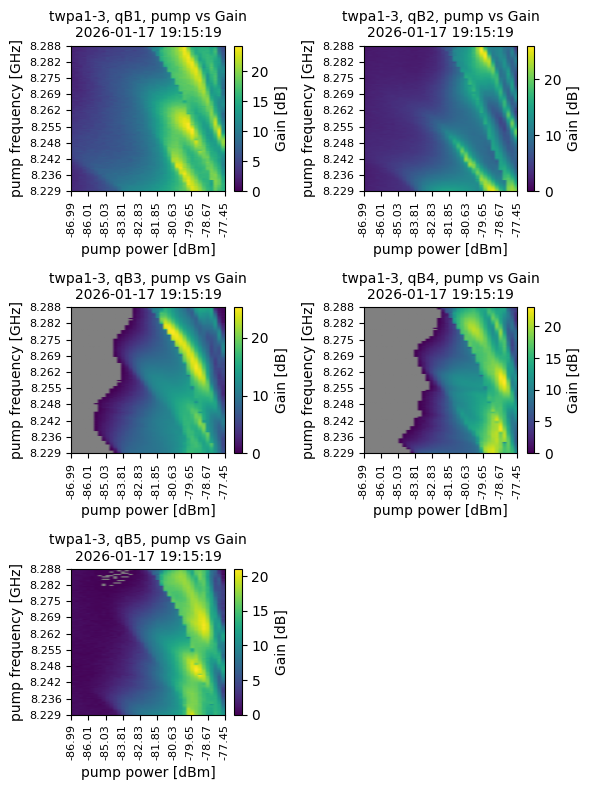

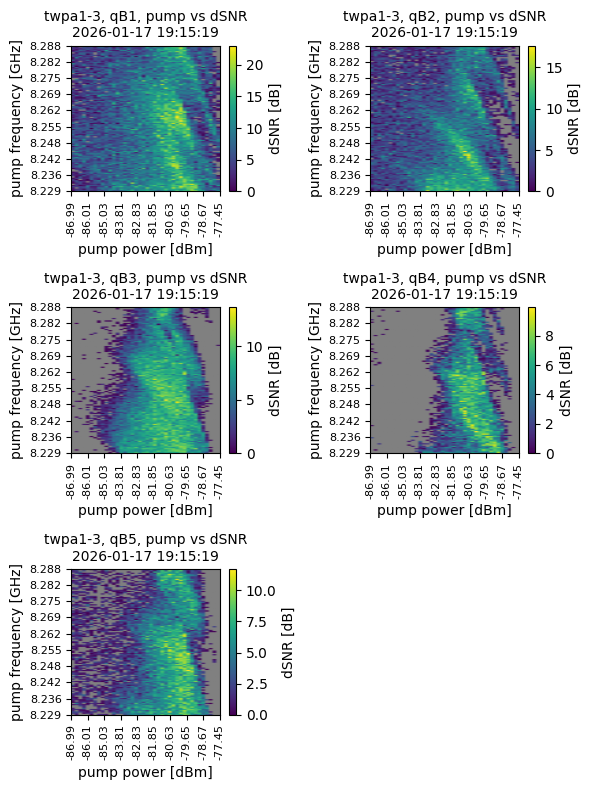

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


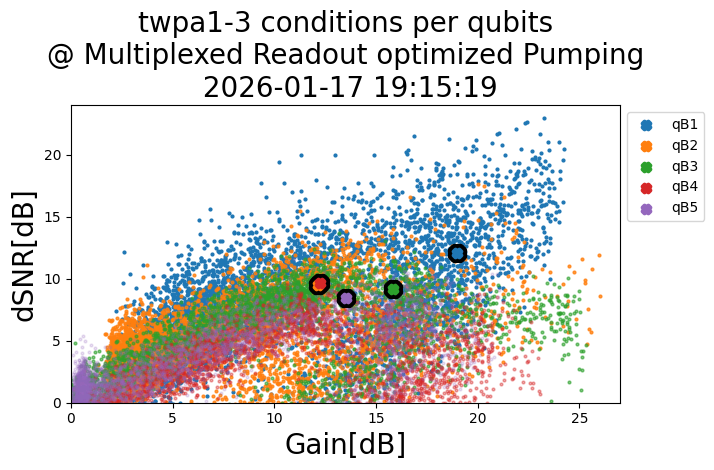

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{twpas[0].id} conditions per qubits\n @ Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

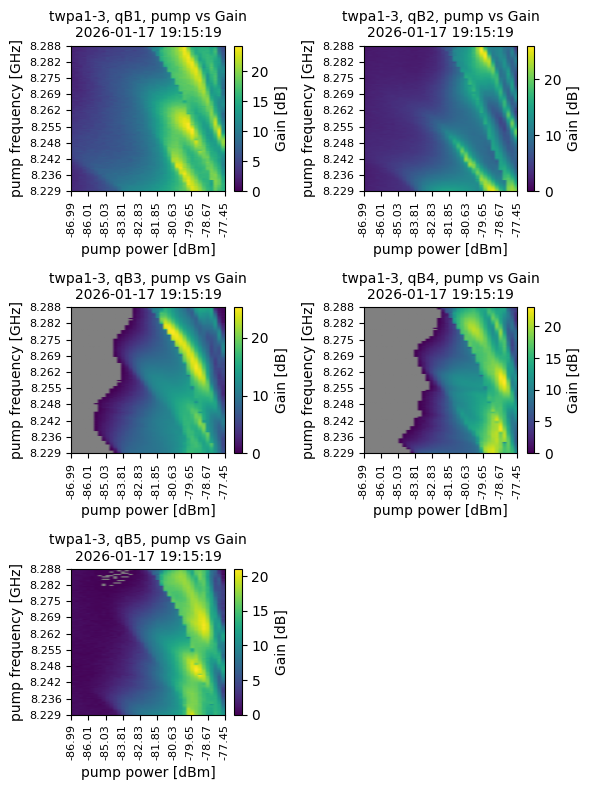

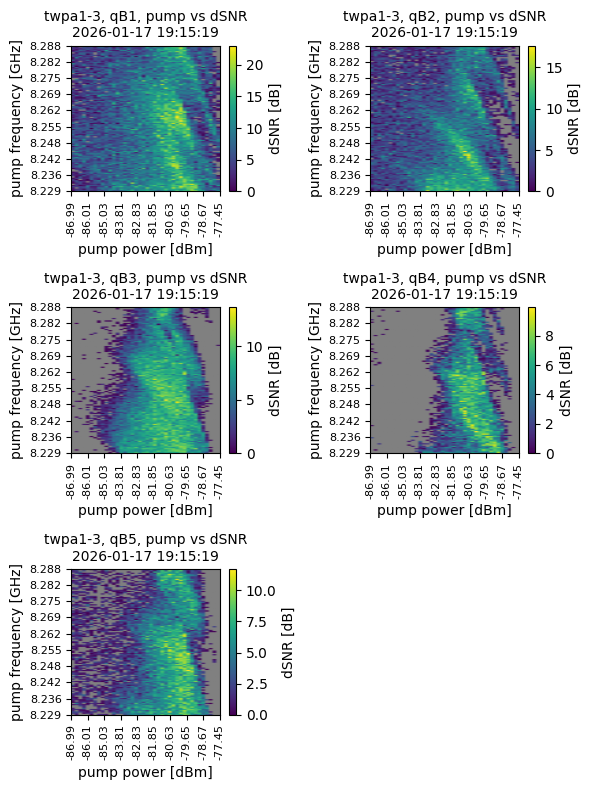

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


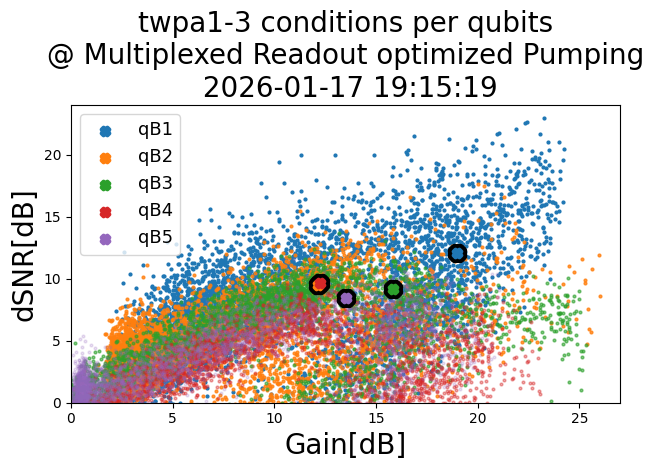

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{twpas[0].id} conditions per qubits\n @ Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=13)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)f
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{twpas[0].id} conditions per qubits\n @ Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=16, length=8, width=2)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=13)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

SyntaxError: invalid syntax (<ipython-input-28-0e50408e6bf4>, line 50)

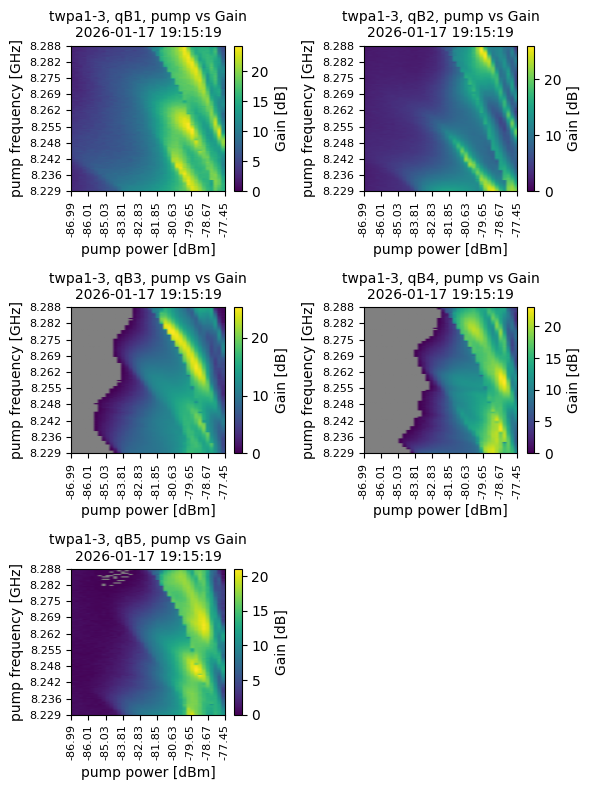

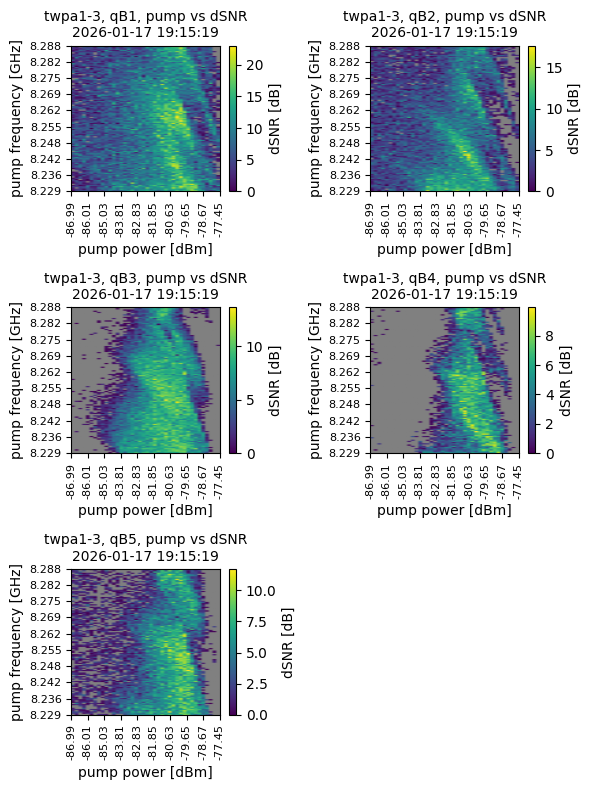

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


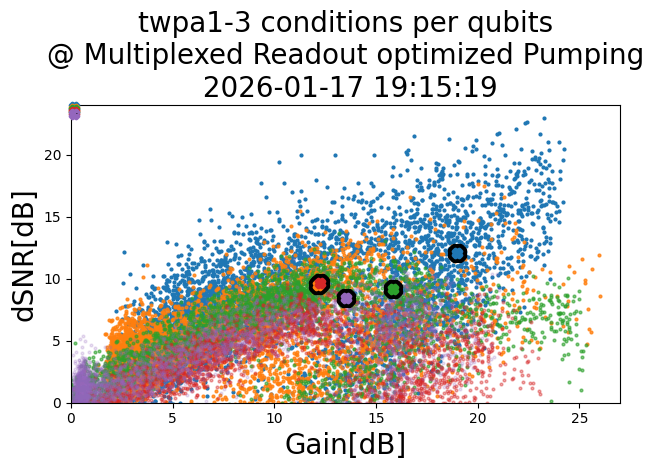

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{twpas[0].id} conditions per qubits\n @ Multiplexed Readout optimized Pumping \n {date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=1)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

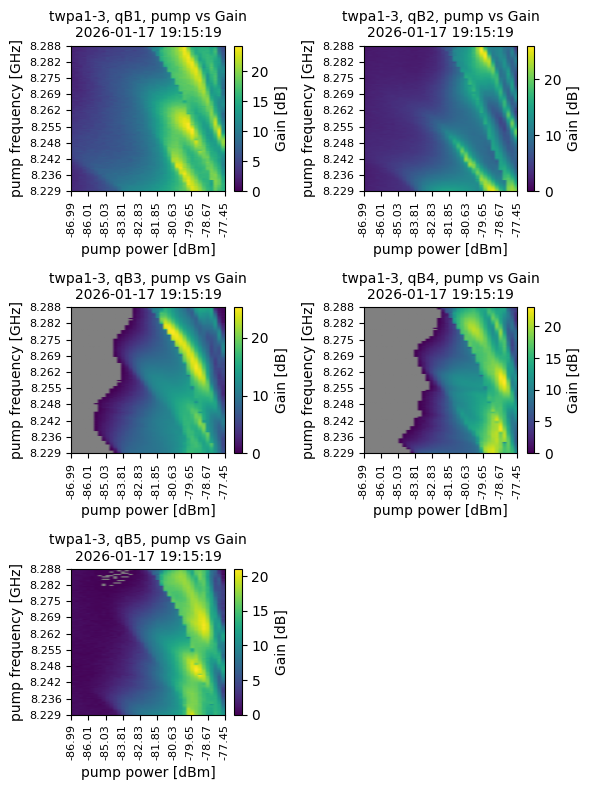

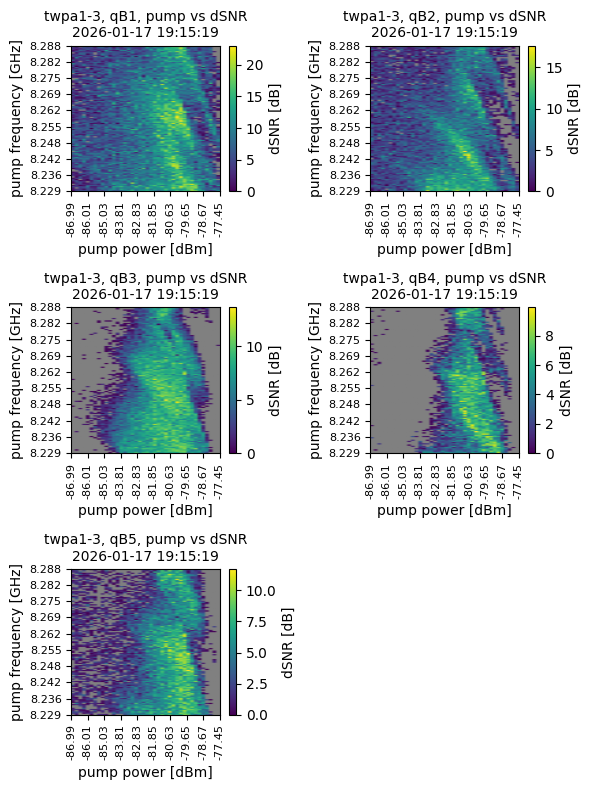

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


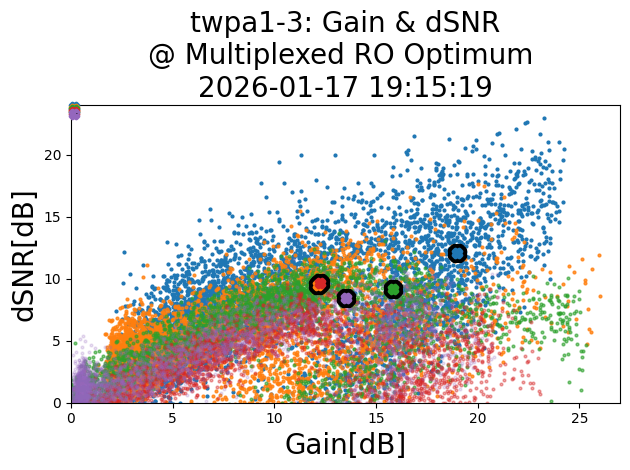

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{twpas[0].id}: Gain & dSNR\n@ Multiplexed RO Optimum \n{date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=1)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

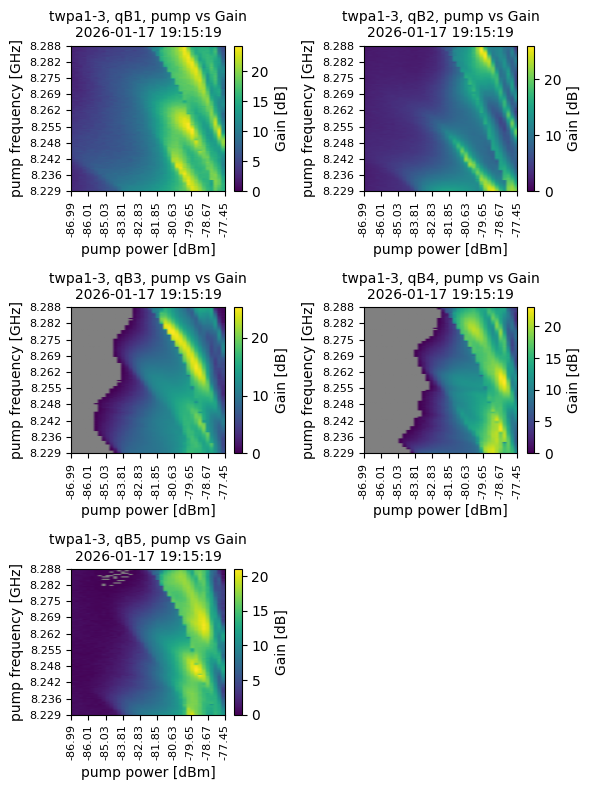

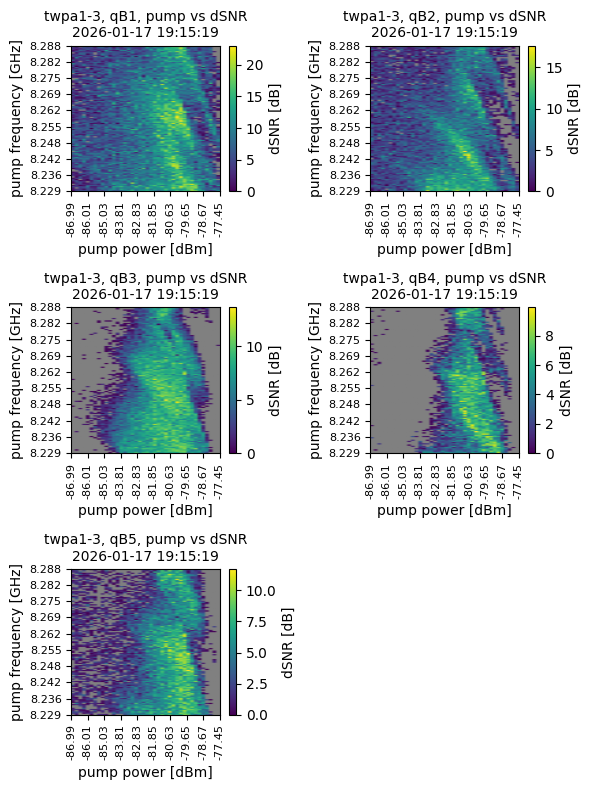

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


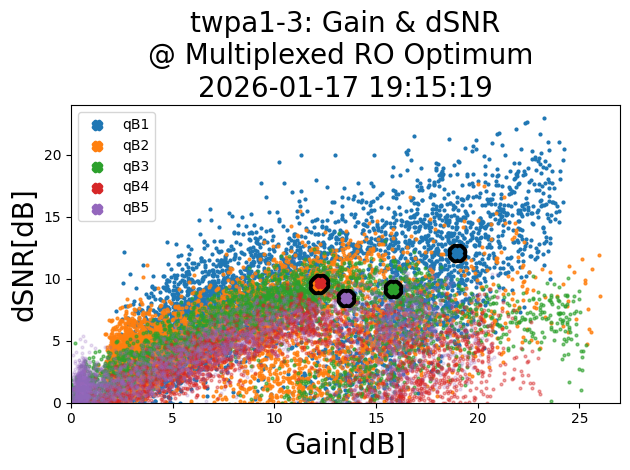

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{twpas[0].id}: Gain & dSNR\n@ Multiplexed RO Optimum \n{date_time}', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=10)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

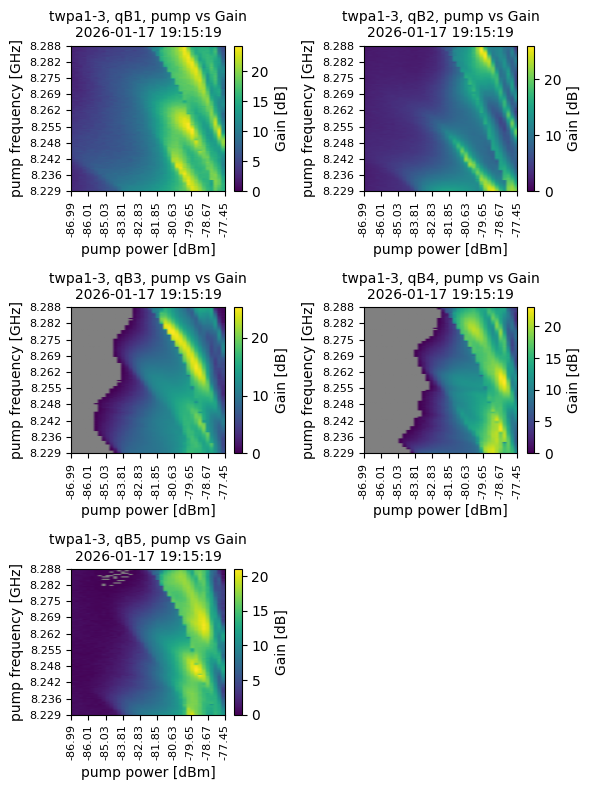

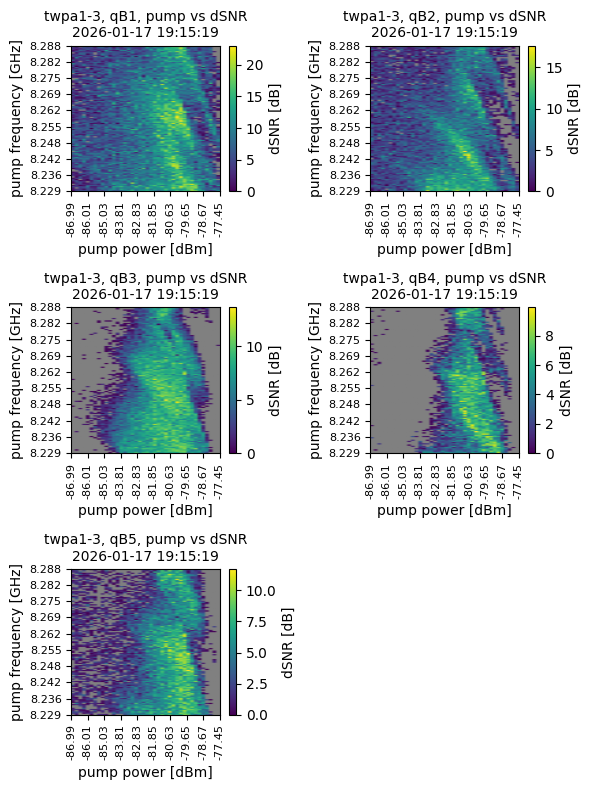

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


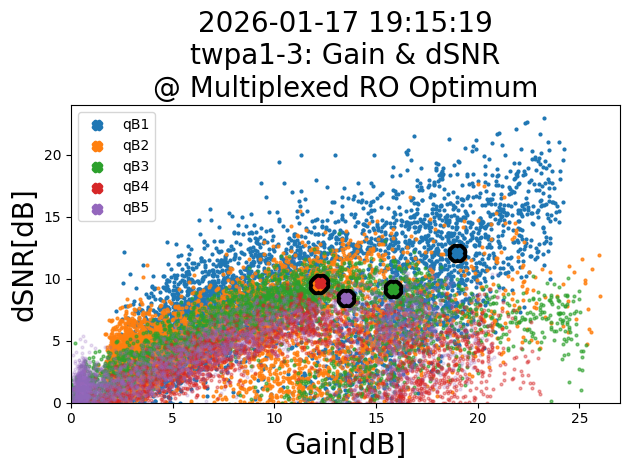

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}\n{twpas[0].id}: Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=10)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

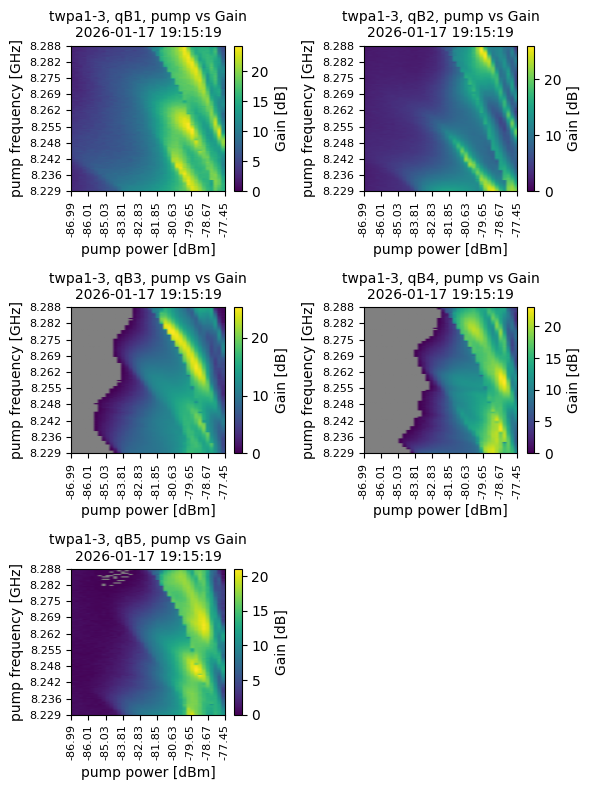

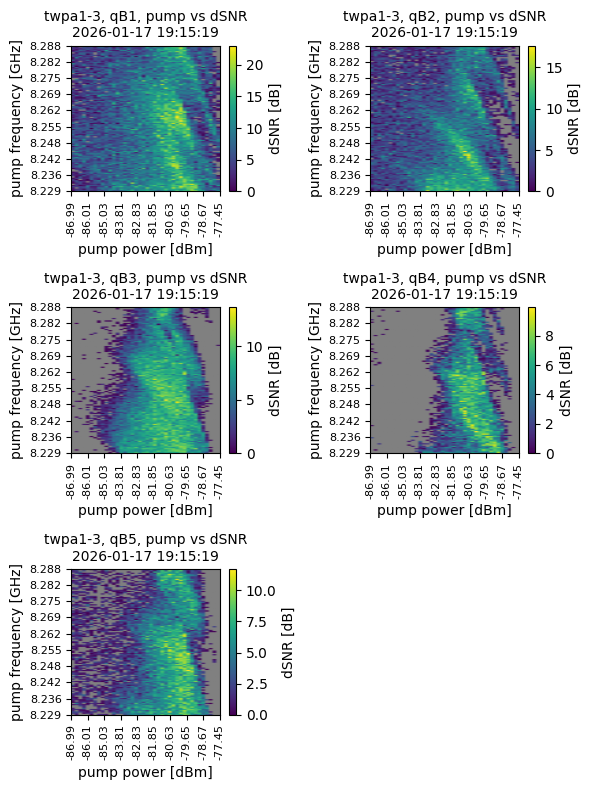

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


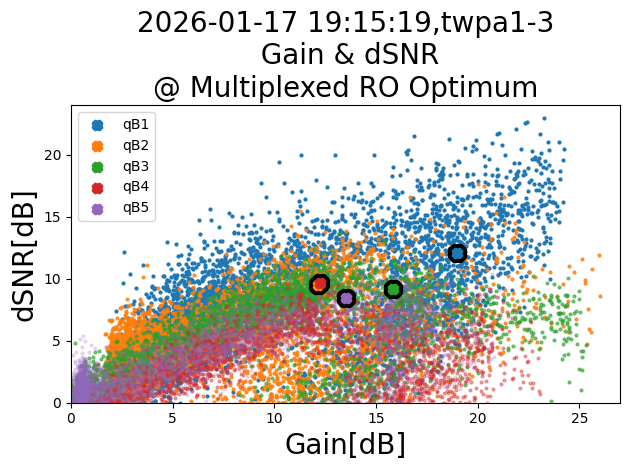

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=10)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

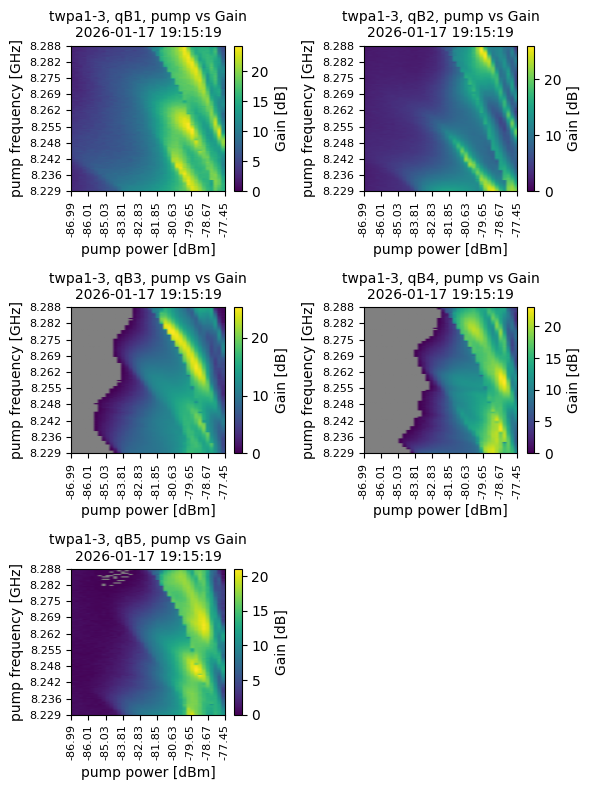

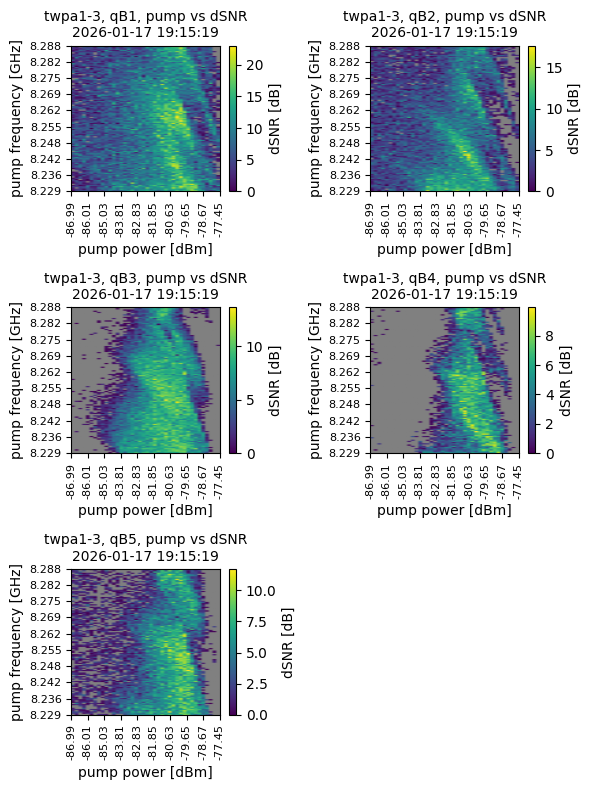

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


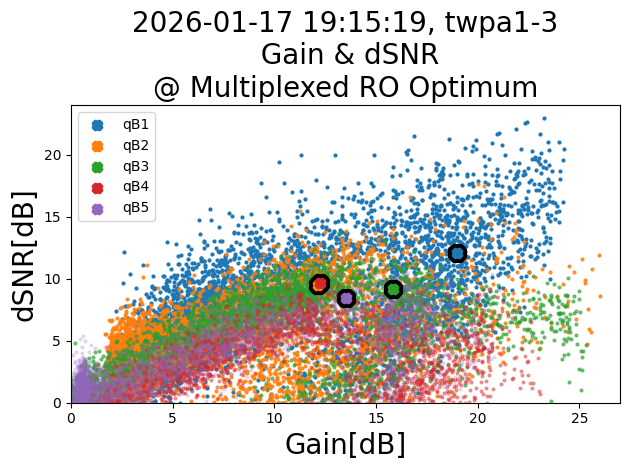

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=10)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

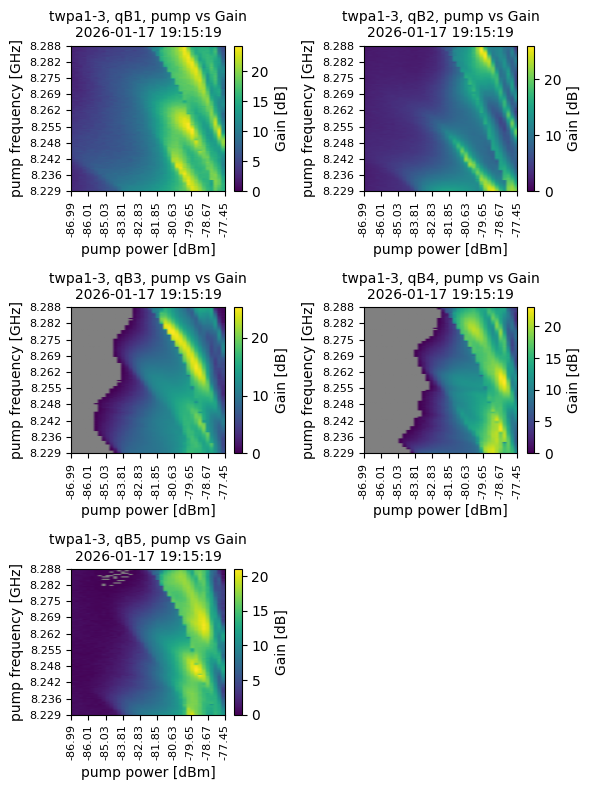

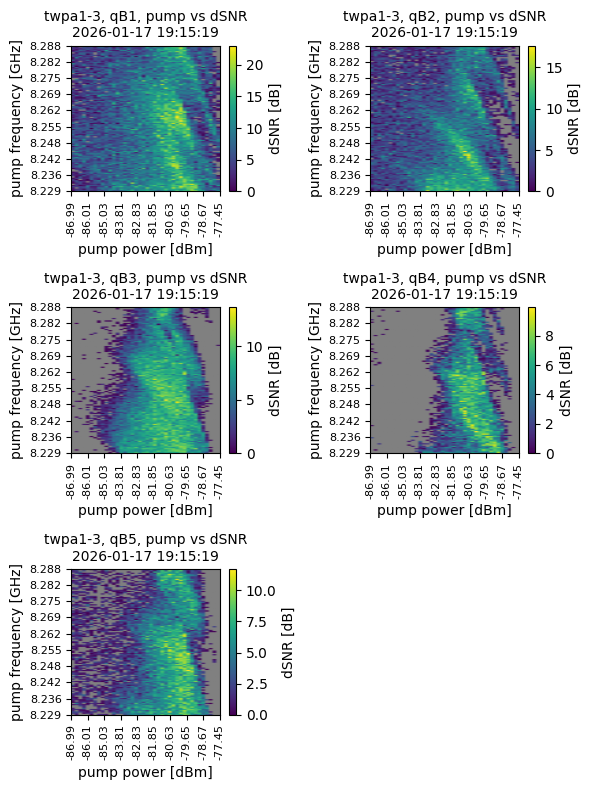

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


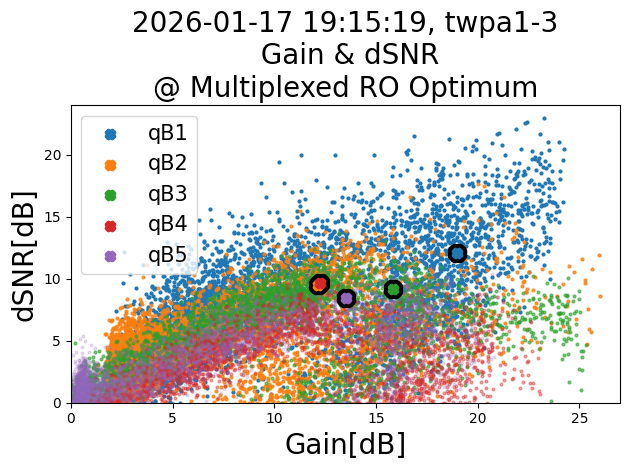

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=15)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

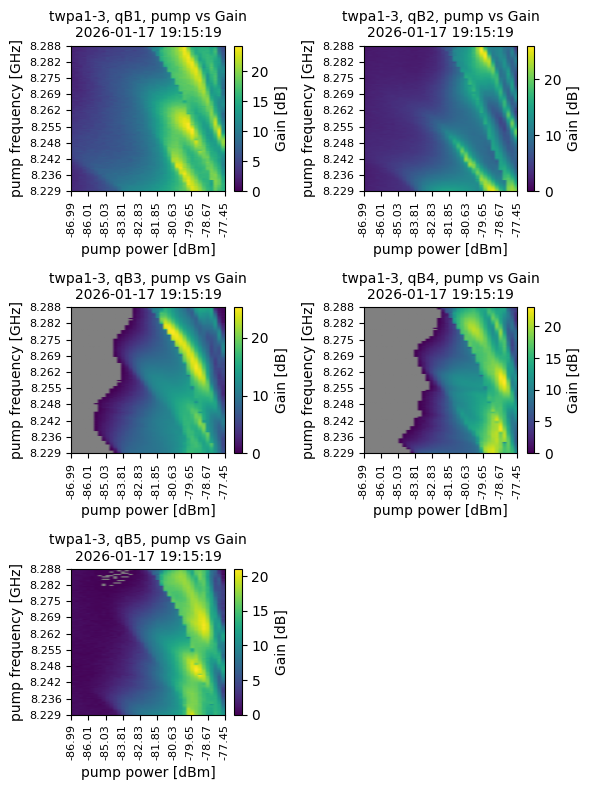

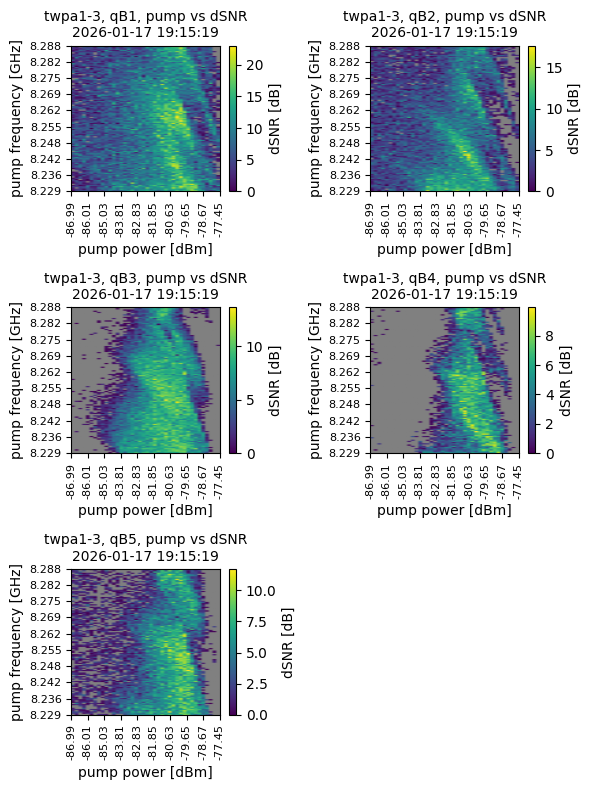

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


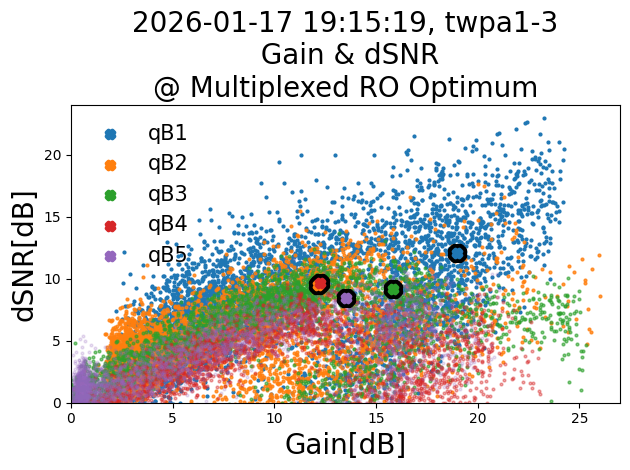

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=15,framealpha=0)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

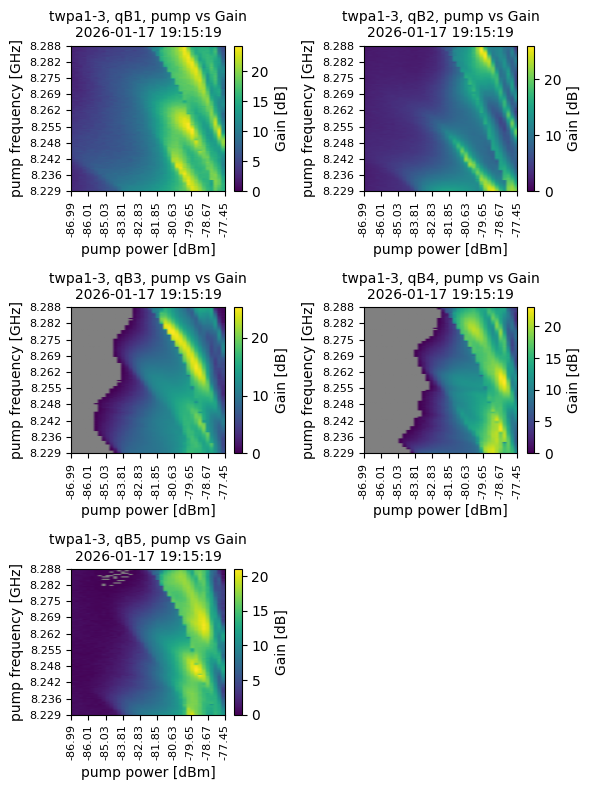

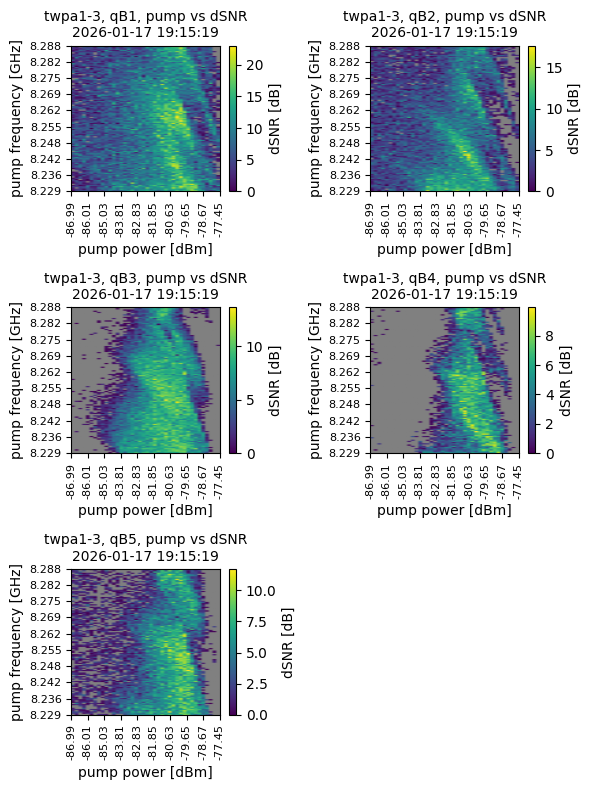

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


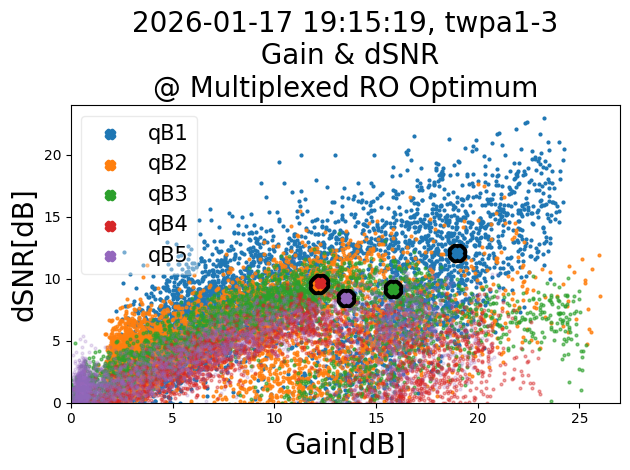

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


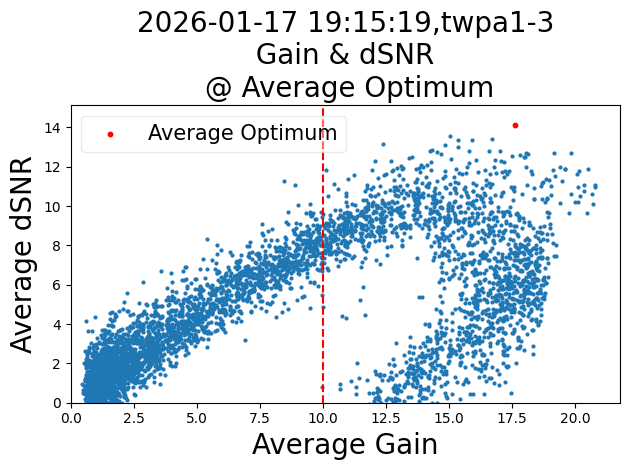

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--')
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


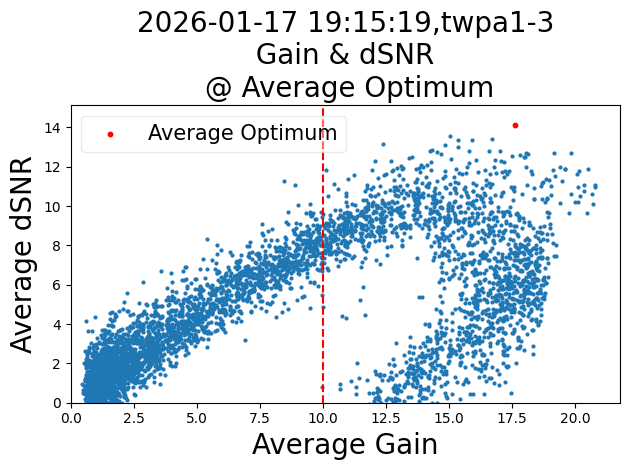

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--')
plt.tight_layout()
window=plt.gcf()
plt.show()

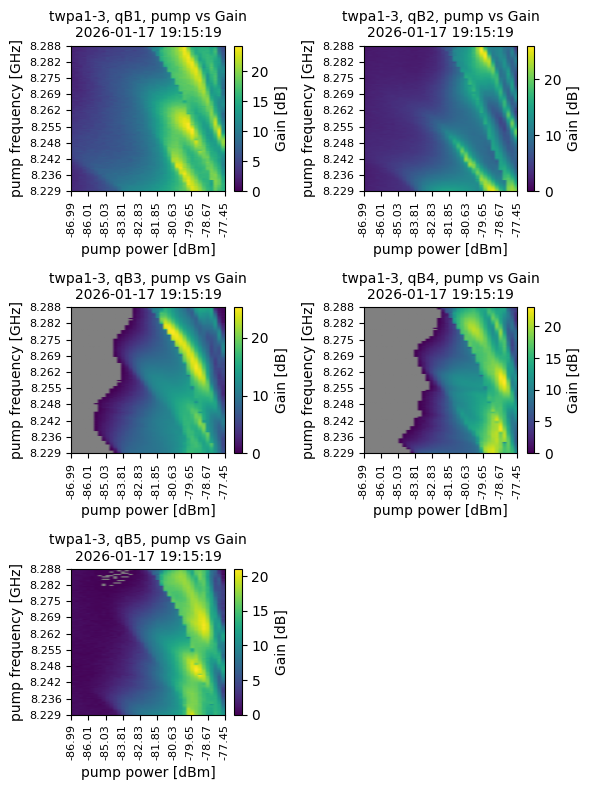

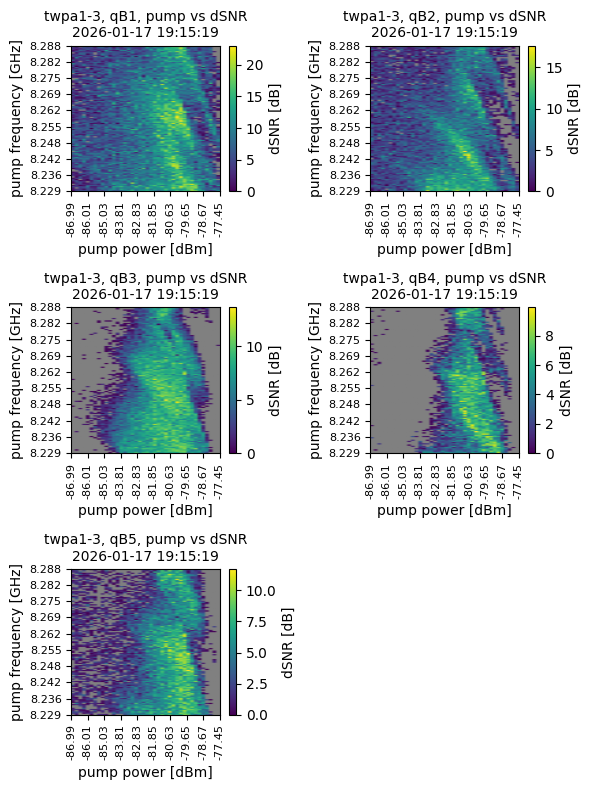

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


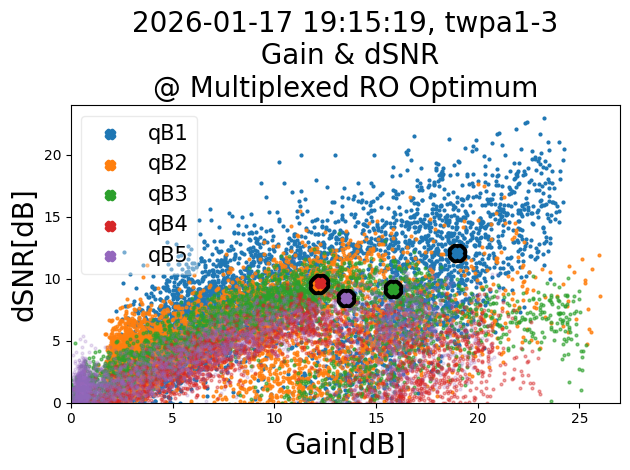

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
### plot gain vs pump  
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        Gain[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap,vmin=0)
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs Gain\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('Gain [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
gain_indiv=plt.gcf()
plt.show()
# plot dSNR vs pump
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8))
axes = axes.flatten()
for i, ax in enumerate(axes[:len(qubits)]):  # only use first num_qubits axes
    im0 = ax.imshow(
        dsnr[i], origin='lower', aspect='auto',
        extent=[0, len(daps) - 1, 0, len(dfps) - 1],
        cmap=cmap, vmin=0
    )
    im0.set_clim(vmin=0, vmax=dsnr[i].max())
    ax.set_xticks(xtick_pos)
    ax.set_xticklabels(selected_powers, rotation=90, fontsize=8)
    ax.set_yticks(ytick_pos)
    ax.set_yticklabels(selected_frequencies, fontsize=8)
    ax.set_title(f'{twpas[0].id}, {qubits[i].name}, pump vs dSNR\n{date_time}', fontsize=10)
    ax.set_xlabel('pump power [dBm]', fontsize=10)
    ax.set_ylabel('pump frequency [GHz]', fontsize=10)
    cbar0 = fig.colorbar(im0, ax=ax)
    cbar0.set_label('dSNR [dB]', fontsize=10)
for ax in axes[len(qubits):]:
    ax.set_visible(False)
plt.tight_layout()
dsnr_indiv=plt.gcf()
plt.show()
#--------------- multiplexed readout optimal point--------------------------------------------
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


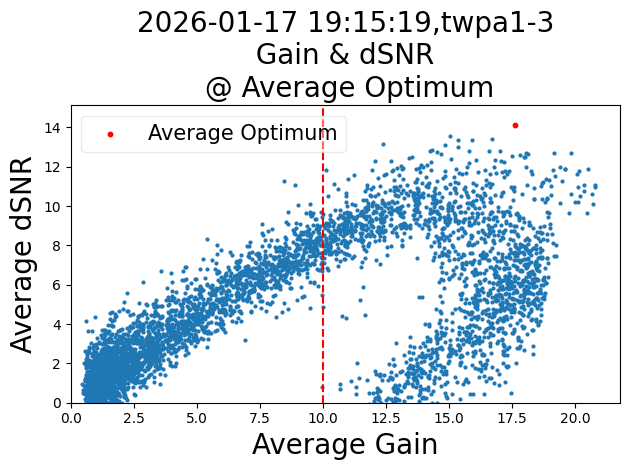

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--')
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


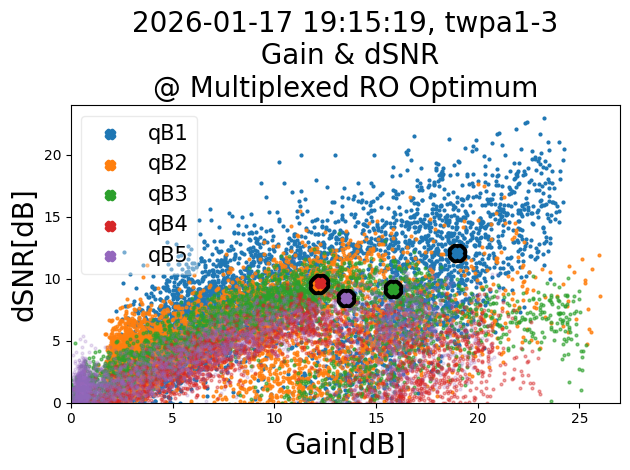

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


TypeError: hlines() missing 2 required positional arguments: 'xmin' and 'xmax'

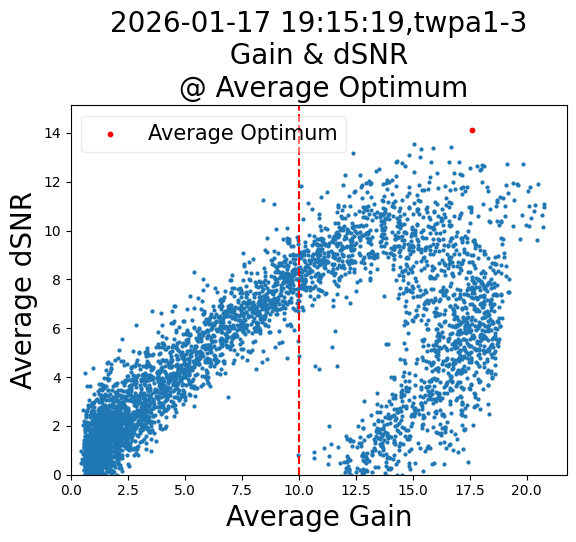

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--')
plt.hlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--')
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


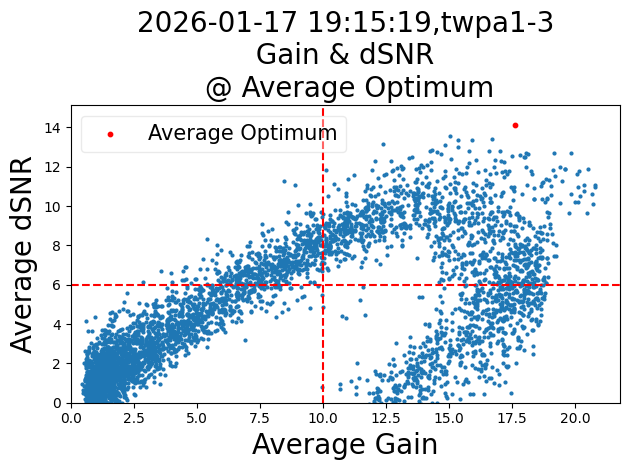

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--')
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--')
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


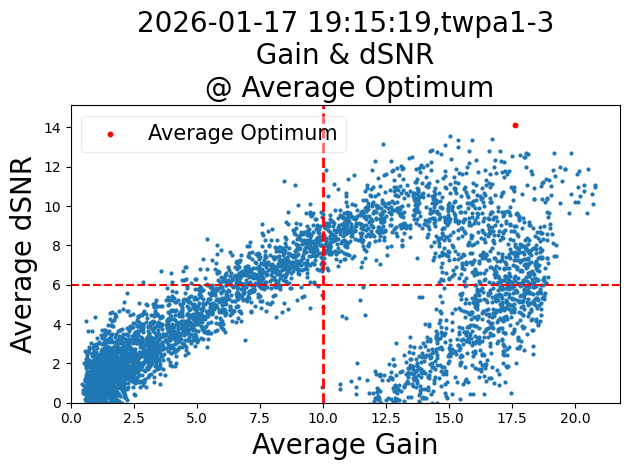

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=2)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--')
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


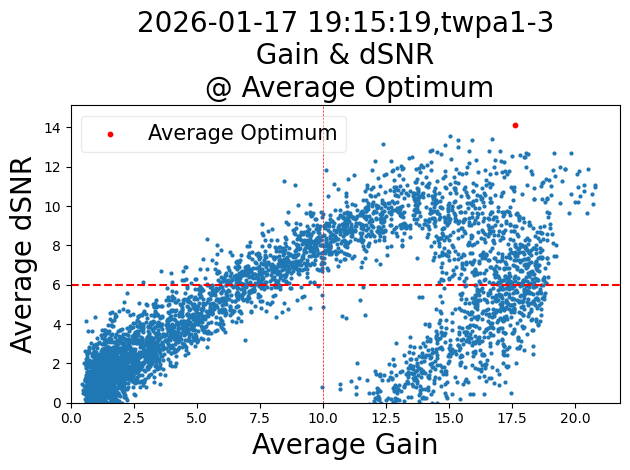

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=0.5)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--')
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


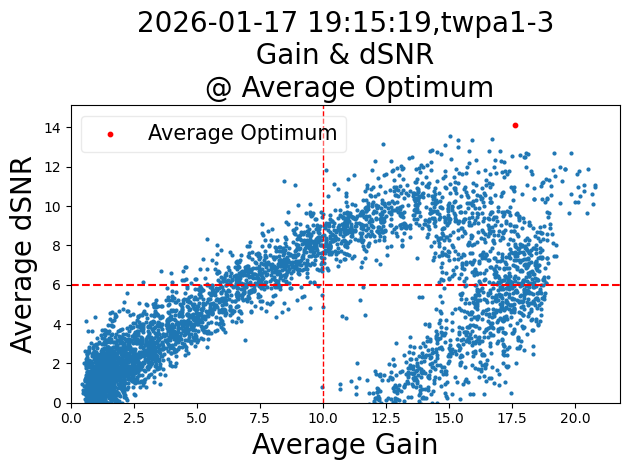

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--')
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


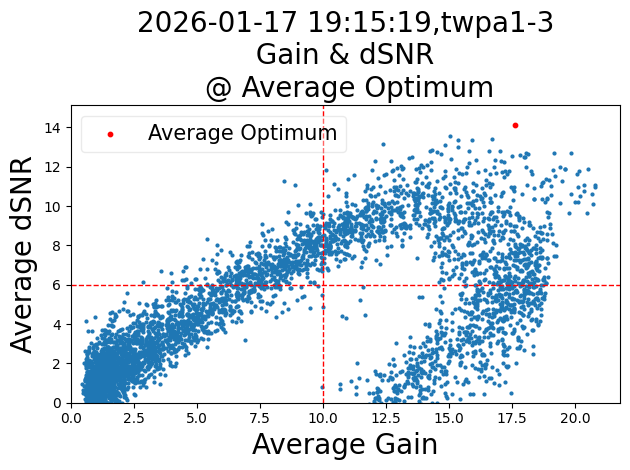

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=6
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.22006,fp=8.244GHz 
@ max dSNR for qB4
qB1:dSNR:12.1dB, gain:19.0dB
qB2:dSNR:9.54dB, gain:12.16dB
qB3:dSNR:9.2dB, gain:15.84dB
qB4:dSNR:9.65dB, gain:12.23dB
qB5:dSNR:8.42dB, gain:13.55dB


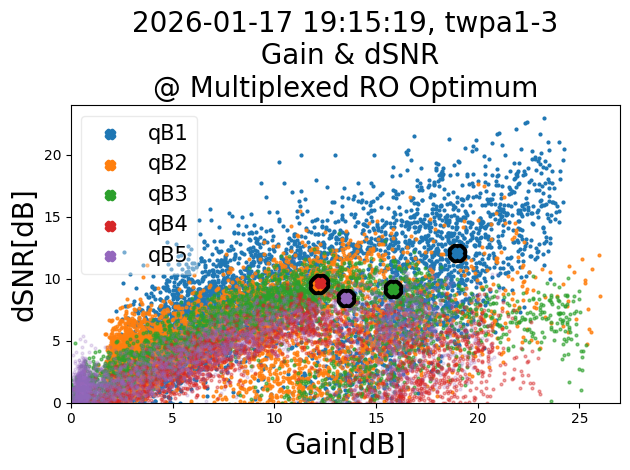

MPLX RO Optimized pumping point 
 at fp=8.244GHz,Pp=-80.14,Pamp=0.22 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mtplx_optimized_pump_idx=multiplexed_optimizer(10,8, qubits, Gain, dsnr,4, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Error: There is no pumping point which satisfies the minimum gain and SNR improvement condition.


TypeError: 'NoneType' object is not subscriptable

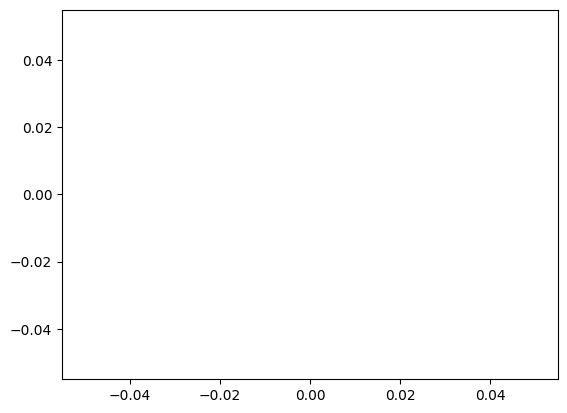

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=10
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Error: There is no pumping point which satisfies the minimum gain and SNR improvement condition.


TypeError: 'NoneType' object is not subscriptable

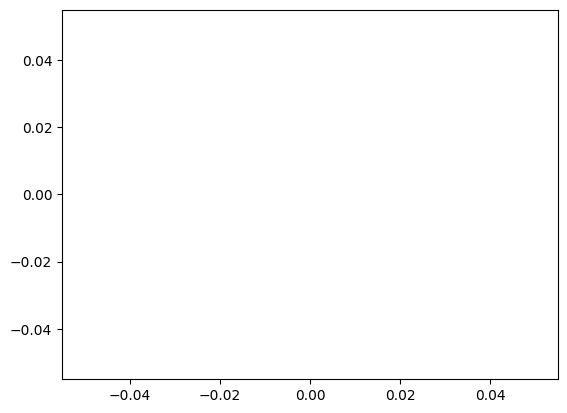

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=9
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.21395,fp=8.239GHz 
qB1:dSNR:21.66dB, gain:23.08dB
qB2:dSNR:14.41dB, gain:20.65dB
qB3:dSNR:8.12dB, gain:12.14dB
qB4:dSNR:8.83dB, gain:13.09dB
qB5:dSNR:8.91dB, gain:12.79dB


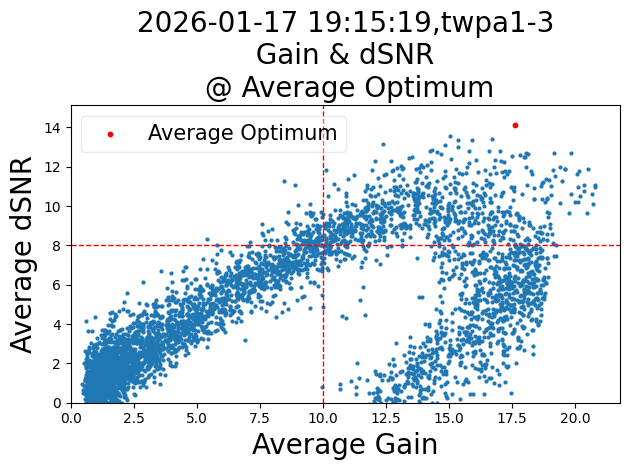

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=8
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.23282,fp=8.232GHz 
qB1:dSNR:15.99dB, gain:23.24dB
qB2:dSNR:10.71dB, gain:19.43dB
qB3:dSNR:9.7dB, gain:16.0dB
qB4:dSNR:8.62dB, gain:16.71dB
qB5:dSNR:9.4dB, gain:17.36dB


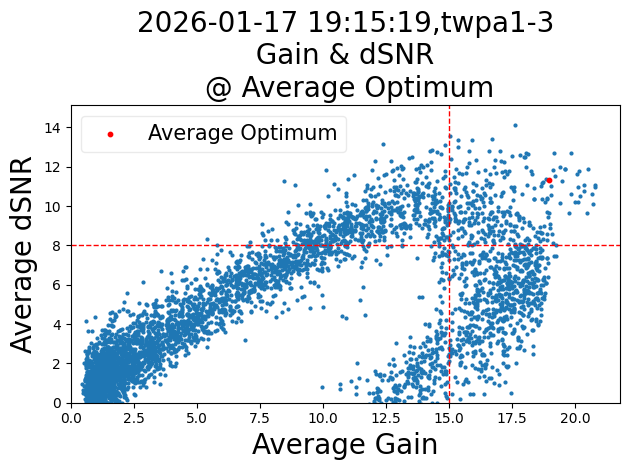

In [ ]:
plt.plot(figzise=(4,3))
mingain=15
mindsnr=8
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Error: There is no pumping point which satisfies the minimum gain and SNR improvement condition.


TypeError: 'NoneType' object is not subscriptable

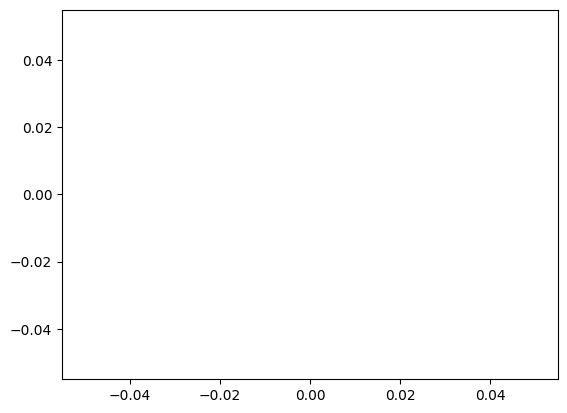

In [ ]:
plt.plot(figzise=(4,3))
mingain=17
mindsnr=8
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.23947,fp=8.236GHz 
qB1:dSNR:13.54dB, gain:19.22dB
qB2:dSNR:9.44dB, gain:16.51dB
qB3:dSNR:9.58dB, gain:17.49dB
qB4:dSNR:8.95dB, gain:17.22dB
qB5:dSNR:9.13dB, gain:17.0dB


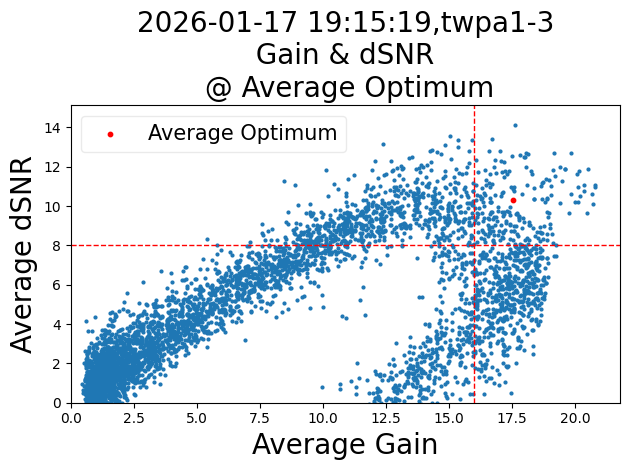

In [ ]:
plt.plot(figzise=(4,3))
mingain=16
mindsnr=8
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.vlines(mingain, ymin=0, ymax=np.max(average_dsnr)+1, color='red', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(average_gain)+1, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.23282,fp=8.262GHz 
@ max dSNR for qB3
qB1:dSNR:17.51dB, gain:17.03dB
qB2:dSNR:12.4dB, gain:15.78dB
qB3:dSNR:12.18dB, gain:16.85dB
qB4:dSNR:8.4dB, gain:13.81dB
qB5:dSNR:10.91dB, gain:15.1dB


TypeError: vlines() missing 2 required positional arguments: 'ymin' and 'ymax'

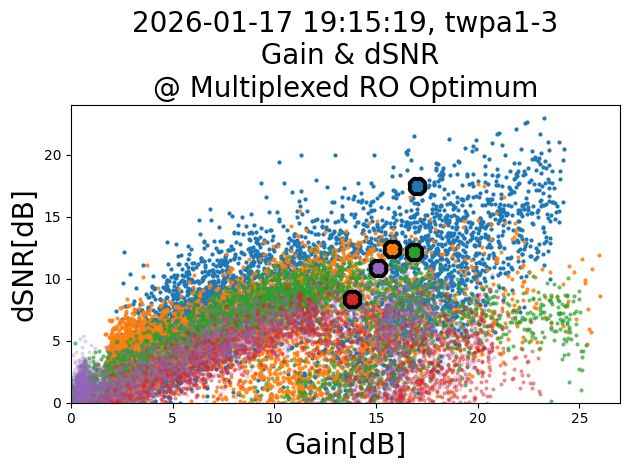

In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=8
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, xmin=0, xmax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, ymin=0, ymax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.23282,fp=8.262GHz 
@ max dSNR for qB3
qB1:dSNR:17.51dB, gain:17.03dB
qB2:dSNR:12.4dB, gain:15.78dB
qB3:dSNR:12.18dB, gain:16.85dB
qB4:dSNR:8.4dB, gain:13.81dB
qB5:dSNR:10.91dB, gain:15.1dB


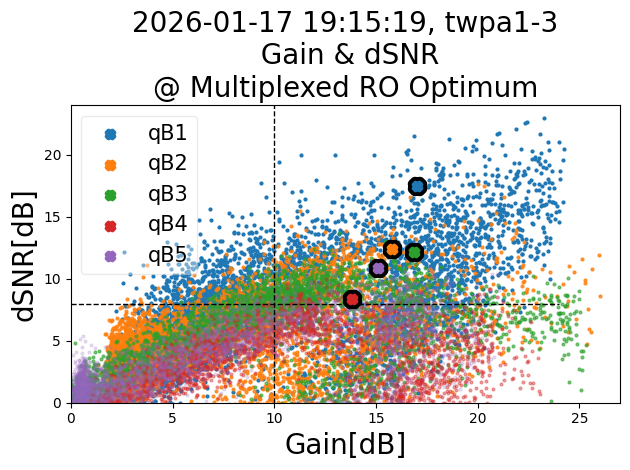

MPLX RO Optimized pumping point 
 at fp=8.262GHz,Pp=-79.65,Pamp=0.233 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=8
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, ymin=0, ymax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.23947,fp=8.236GHz 
qB1:dSNR:13.54dB, gain:19.22dB
qB2:dSNR:9.44dB, gain:16.51dB
qB3:dSNR:9.58dB, gain:17.49dB
qB4:dSNR:8.95dB, gain:17.22dB
qB5:dSNR:9.13dB, gain:17.0dB


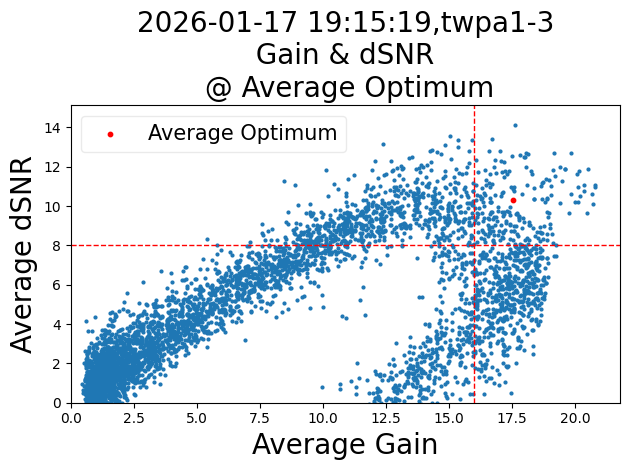

In [ ]:
plt.plot(figzise=(4,3))
mingain=16
mindsnr=8
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Gain & dSNR \n @ Average Optimum', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.axvline(mingain, color='red', linestyle='--', linewidth=1)
plt.axhline(mindsnr, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.23282,fp=8.262GHz 
@ max dSNR for qB3
qB1:dSNR:17.51dB, gain:17.03dB
qB2:dSNR:12.4dB, gain:15.78dB
qB3:dSNR:12.18dB, gain:16.85dB
qB4:dSNR:8.4dB, gain:13.81dB
qB5:dSNR:10.91dB, gain:15.1dB


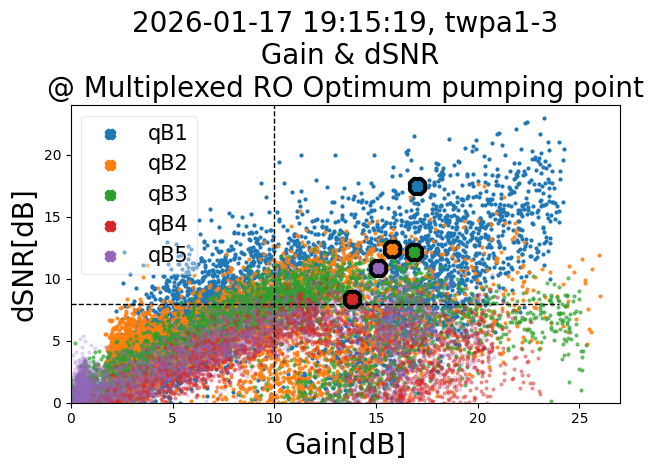

MPLX RO Optimized pumping point 
 at fp=8.262GHz,Pp=-79.65,Pamp=0.233 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=8
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum pumping point', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, ymin=0, ymax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.23947,fp=8.236GHz 
qB1:dSNR:13.54dB, gain:19.22dB
qB2:dSNR:9.44dB, gain:16.51dB
qB3:dSNR:9.58dB, gain:17.49dB
qB4:dSNR:8.95dB, gain:17.22dB
qB5:dSNR:9.13dB, gain:17.0dB


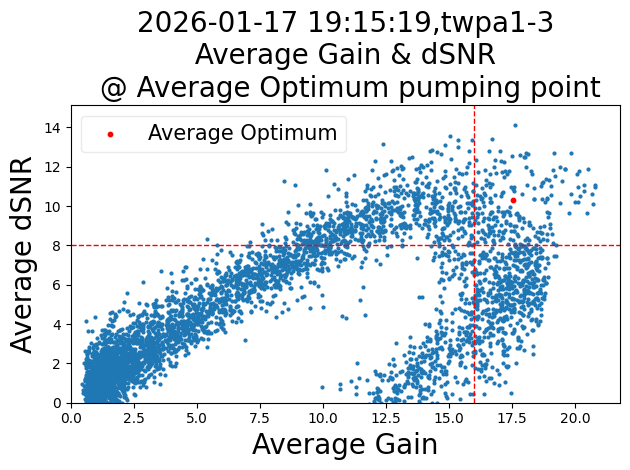

In [ ]:
plt.plot(figzise=(4,3))
mingain=16
mindsnr=8
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Average Gain & dSNR \n @ Average Optimum pumping point', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.axvline(mingain, color='red', linestyle='--', linewidth=1)
plt.axhline(mindsnr, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

Optimized ap=0.23282,fp=8.262GHz 
@ max dSNR for qB3
qB1:dSNR:17.51dB, gain:17.03dB
qB2:dSNR:12.4dB, gain:15.78dB
qB3:dSNR:12.18dB, gain:16.85dB
qB4:dSNR:8.4dB, gain:13.81dB
qB5:dSNR:10.91dB, gain:15.1dB


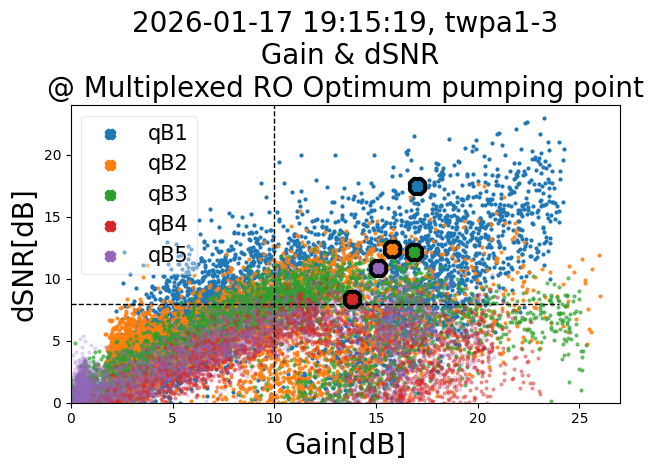

MPLX RO Optimized pumping point 
 at fp=8.262GHz,Pp=-79.65,Pamp=0.233 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=8
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum pumping point', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, ymin=0, ymax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

In [ ]:
avg_operation_point={'fp':np.round((p_lo+p_if+dfps[avg_optimized_pump[0]]),3), 
                 'Pp': node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[avg_optimized_pump[1]]),
                 'Pamp': np.round(daps[avg_optimized_pump[1]],3)}
node.results["avg_operation_point"] = avg_operation_point
node.results["multiplexed_RO_operation_point"]={'fp':np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]]),3), 
                 'Pp': node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),
                 'Pamp': np.round(daps[mtplx_optimized_pump_idx[1]],3)}
node.results["Ps"]={"Ps":readout_power}
node.results["figures"]={"signal": s,
                         "noise": n,
                         "map": map,
                         "operation_window" : window,
                         "gain_indiv":gain_indiv,
                         "dsnr_indiv":dsnr_indiv,
                         "multiplexed_window": multiplexed_optimization}
if not node.parameters.load_data_id:
    with node.record_state_updates():        
        machine.twpas[twpa_].pump_frequency=dfps[avg_optimized_pump[0]]
        machine.twpas[twpa_].pump_amplitude=daps[avg_optimized_pump[1]]
        machine.twpas[twpa_].mltpx_pump_frequency=dfps[mtplx_optimized_pump_idx[0]]
        machine.twpas[twpa_].mltpx_pump_amplitude=daps[mtplx_optimized_pump_idx[1]]
        machine.twpas[twpa_].max_avg_gain=np.round(np.max(np.mean(average_gain,axis=0)))
        machine.twpas[twpa_].max_avg_snr_improvement=np.round(np.max(np.mean(average_dsnr,axis=0)))

In [ ]:
node.outcomes = {q.name: "successful" for q in qubits}
node.results["initial_parameters"] = node.parameters.model_dump()
node.machine = machine
node.save()

2026-01-17 19:54:11,666 - INFO - Saving node with snapshot index 3253
2026-01-17 19:54:11,676 - qualibrate - INFO - Saving node 00a_twpa1_3_calibration_MTPLX_RO to local storage
2026-01-17 19:54:13,114 - qualibrate - INFO - Saving machine to active path C:\Users\KimJeongwon\qw_statestore_QCC\quam_state
2026-01-17 19:54:13,169 - qualibrate - INFO - Saving machine to data folder C:\Users\KimJeongwon\.qualibrate\user_storage\JWKim\2026-01-17\#3253_00a_twpa1_3_calibration_MTPLX_RO_195411\quam_state
2026-01-17 19:54:13,213 - INFO - Node saved locally
2026-01-17 19:54:13,221 - INFO - Found quantum computer backend: arbel
2026-01-17 19:54:27,052 - INFO - Node successfully uploaded to cloud


Optimized ap=0.20223,fp=8.25GHz 
@ max dSNR for qB3
qB1:dSNR:14.86dB, gain:17.38dB
qB2:dSNR:9.69dB, gain:11.44dB
qB3:dSNR:13.68dB, gain:13.18dB
qB4:dSNR:6.61dB, gain:11.05dB
qB5:dSNR:5.42dB, gain:10.96dB


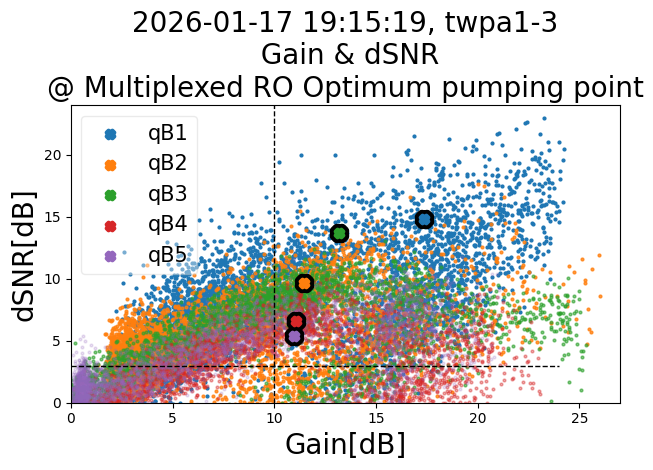

MPLX RO Optimized pumping point 
 at fp=8.25GHz,Pp=-80.87,Pamp=0.202 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=3
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum pumping point', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, ymin=0, ymax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

In [ ]:
daps[mtplx_optimized_pump_idx[1]]

0.20223064087531858

In [ ]:
dfps[mtplx_optimized_pump_idx[0]]

-8500000.0

Optimized ap=0.20223,fp=8.25GHz 
@ max dSNR for qB3
qB1:dSNR:14.86dB, gain:17.38dB
qB2:dSNR:9.69dB, gain:11.44dB
qB3:dSNR:13.68dB, gain:13.18dB
qB4:dSNR:6.61dB, gain:11.05dB
qB5:dSNR:5.42dB, gain:10.96dB


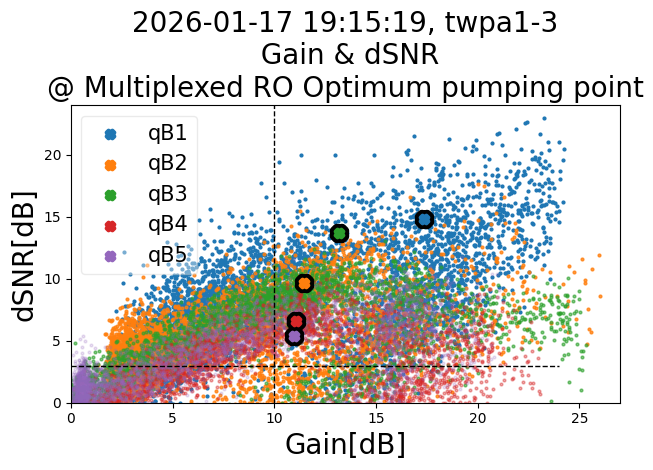

MPLX RO Optimized pumping point 
 at fp=8.25GHz,Pp=-80.87,Pamp=0.202 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=3
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    sc = plt.scatter(
        Gain[i], dsnr[i], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum pumping point', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, ymin=0, ymax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.20223,fp=8.25GHz 
@ max dSNR for qB3
qB1:dSNR:14.86dB, gain:17.38dB
qB2:dSNR:9.69dB, gain:11.44dB
qB3:dSNR:13.68dB, gain:13.18dB
qB4:dSNR:6.61dB, gain:11.05dB
qB5:dSNR:5.42dB, gain:10.96dB


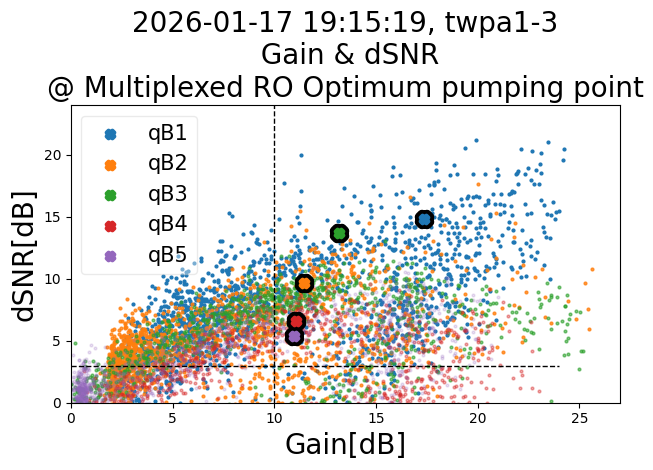

MPLX RO Optimized pumping point 
 at fp=8.25GHz,Pp=-80.87,Pamp=0.202 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=3
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    # Downsample: plot every 10th point for better visibility
    gain_flat = np.array(Gain[i]).flatten()
    dsnr_flat = np.array(dsnr[i]).flatten()
    sc = plt.scatter(
        gain_flat[::3], dsnr_flat[::3], s=4,
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum pumping point', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, ymin=0, ymax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.20223,fp=8.25GHz 
@ max dSNR for qB3
qB1:dSNR:14.86dB, gain:17.38dB
qB2:dSNR:9.69dB, gain:11.44dB
qB3:dSNR:13.68dB, gain:13.18dB
qB4:dSNR:6.61dB, gain:11.05dB
qB5:dSNR:5.42dB, gain:10.96dB


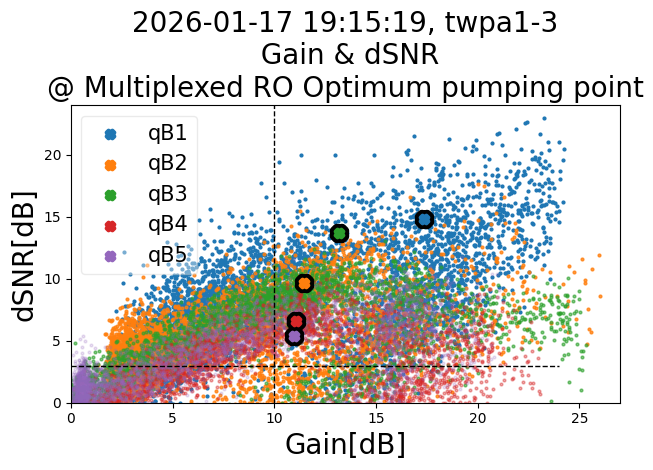

MPLX RO Optimized pumping point 
 at fp=8.25GHz,Pp=-80.87,Pamp=0.202 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=3
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    gain_flat = np.array(Gain[i]).flatten()
    dsnr_flat = np.array(dsnr[i]).flatten()
    sc = plt.scatter(
        gain_flat[::1], dsnr_flat[::1], s=4, # downsample
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=50,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=30,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum pumping point', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, ymin=0, ymax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.20223,fp=8.25GHz 
@ max dSNR for qB3
qB1:dSNR:14.86dB, gain:17.38dB
qB2:dSNR:9.69dB, gain:11.44dB
qB3:dSNR:13.68dB, gain:13.18dB
qB4:dSNR:6.61dB, gain:11.05dB
qB5:dSNR:5.42dB, gain:10.96dB


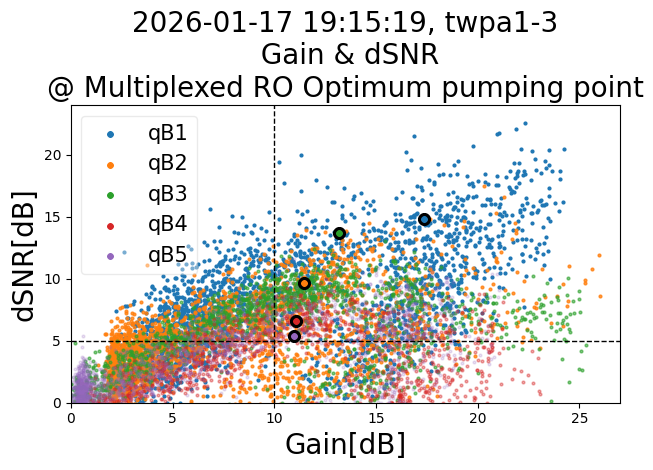

MPLX RO Optimized pumping point 
 at fp=8.25GHz,Pp=-80.87,Pamp=0.202 
 2026-01-17 19:15:19 
 40*40*120*30


In [ ]:
plt.plot(figzise=(4,3))
mingain=10
mindsnr=5
poorqubit=3
mtplx_optimized_pump_idx=multiplexed_optimizer(mingain,mindsnr, qubits, Gain, dsnr,poorqubit, dfps, daps, p_lo,p_if)
colors=[]
for i in range(len(qubits)):
    gain_flat = np.array(Gain[i]).flatten()
    dsnr_flat = np.array(dsnr[i]).flatten()
    sc = plt.scatter(
        gain_flat[::2], dsnr_flat[::2], s=4, # downsample
        alpha=1 - 0.2*i
    )
    colors.append(sc.get_facecolor()[0])
for i in range(len(qubits)):
    # Plot black outline (larger, behind)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=5,marker='X',color='black',linewidths=7,zorder=9,alpha=1)
    # Plot colored marker (smaller, on top)
    plt.scatter(Gain[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], dsnr[i][mtplx_optimized_pump_idx[0]][mtplx_optimized_pump_idx[1]], s=3,marker='X',color=colors[i],linewidths=3,zorder=10,alpha=1,label=f'qB{i+1}')
plt.title(f'{date_time}, {twpas[0].id}\n Gain & dSNR\n@ Multiplexed RO Optimum pumping point', fontsize=20)
plt.xlabel('Gain[dB]', fontsize=20)
plt.ylabel('dSNR[dB]', fontsize=20)
plt.xlim(0,np.max(Gain)+1)
plt.ylim(0,np.max(dsnr)+1)
plt.tight_layout()
plt.vlines(mingain, ymin=0, ymax=np.max(dsnr)+1, color='black', linestyle='--', linewidth=1)
plt.hlines(mindsnr, xmin=0, xmax=np.max(Gain)+1, color='black', linestyle='--', linewidth=1)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
multiplexed_optimization=plt.gcf()
plt.show()
print(f'MPLX RO Optimized pumping point \n at fp={np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),2)},Pamp={np.round(daps[mtplx_optimized_pump_idx[1]],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

Optimized ap=0.23947,fp=8.236GHz 
qB1:dSNR:13.54dB, gain:19.22dB
qB2:dSNR:9.44dB, gain:16.51dB
qB3:dSNR:9.58dB, gain:17.49dB
qB4:dSNR:8.95dB, gain:17.22dB
qB5:dSNR:9.13dB, gain:17.0dB


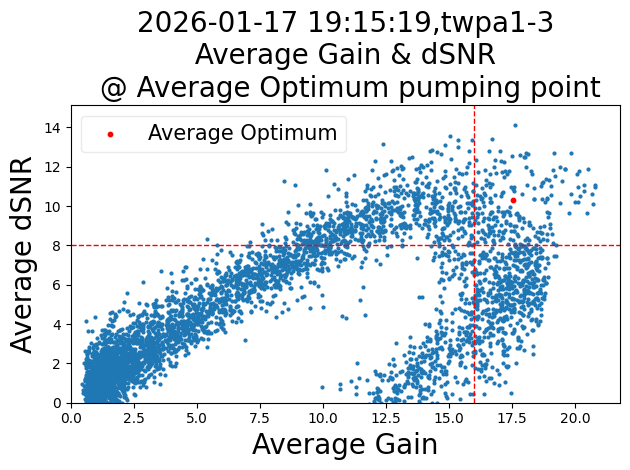

In [ ]:
plt.plot(figzise=(4,3))
mingain=16
mindsnr=8
avg_optimized_pump=optimizer(mingain, mindsnr,  Gain, dsnr,  average_dsnr, dfps, daps, p_lo,p_if)
for i in range(len(qubits)):
    print(f"{qubits[i].id}:dSNR:{np.round(dsnr[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB, gain:{np.round(Gain[i][avg_optimized_pump[0]][avg_optimized_pump[1]][0],2)}dB")
plt.scatter(average_gain, average_dsnr, s=4)
plt.scatter(average_gain[avg_optimized_pump],  average_dsnr[avg_optimized_pump], s=10, color='red', label='Average Optimum')
plt.title(f'{date_time},{twpas[0].id}\n Average Gain & dSNR \n @ Average Optimum pumping point', fontsize=20)
plt.legend(loc='upper left',fontsize=15,framealpha=0.4)#, bbox_to_anchor=(1, 1))
plt.xlabel('Average Gain', fontsize=20)
plt.ylabel('Average dSNR', fontsize=20)
plt.xlim(0,np.max(average_gain)+1)
plt.ylim(0,np.max(average_dsnr)+1)
plt.axvline(mingain, color='red', linestyle='--', linewidth=1)
plt.axhline(mindsnr, color='red', linestyle='--', linewidth=1)
plt.tight_layout()
window=plt.gcf()
plt.show()

calibration time = 311.04 sec


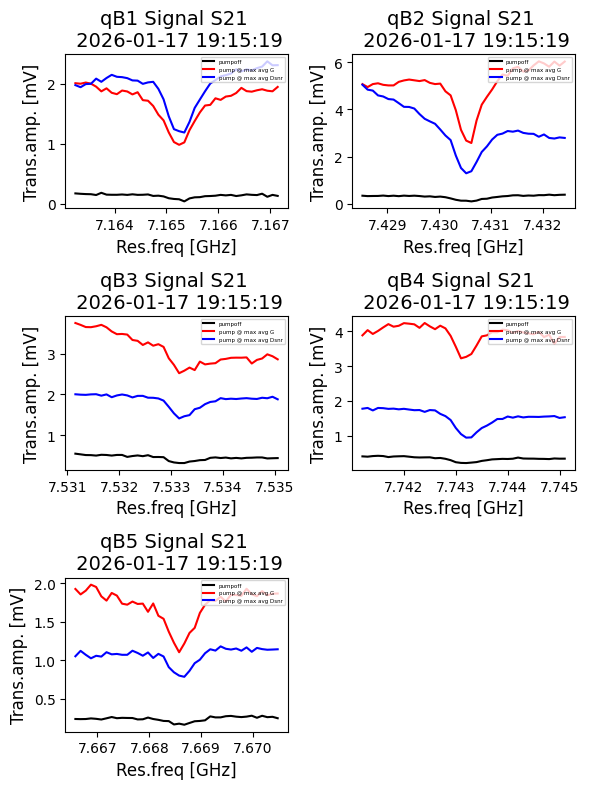

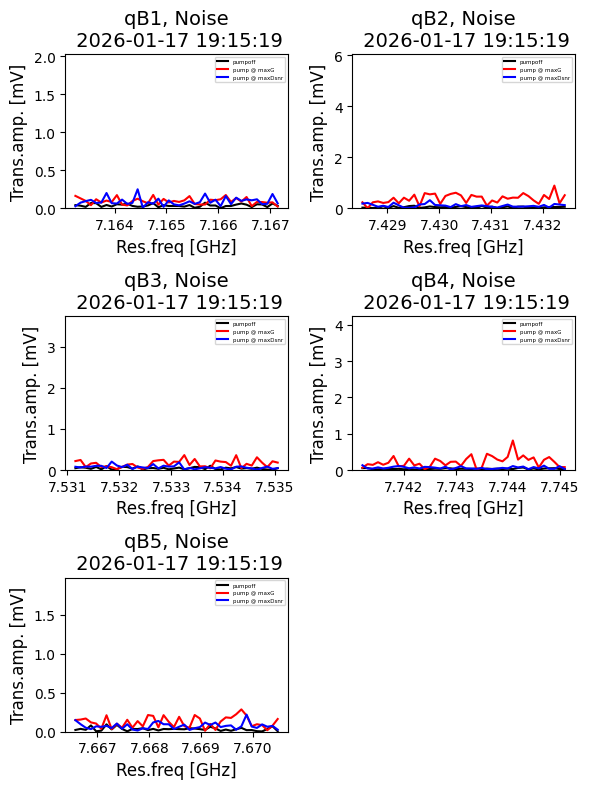

max Avg dSNR(14.14dB) 
 at fp=8.239GHz,Pp=-80.38,Pamp=0.214 
 2026-01-17 19:15:19 
 40*40*120*30


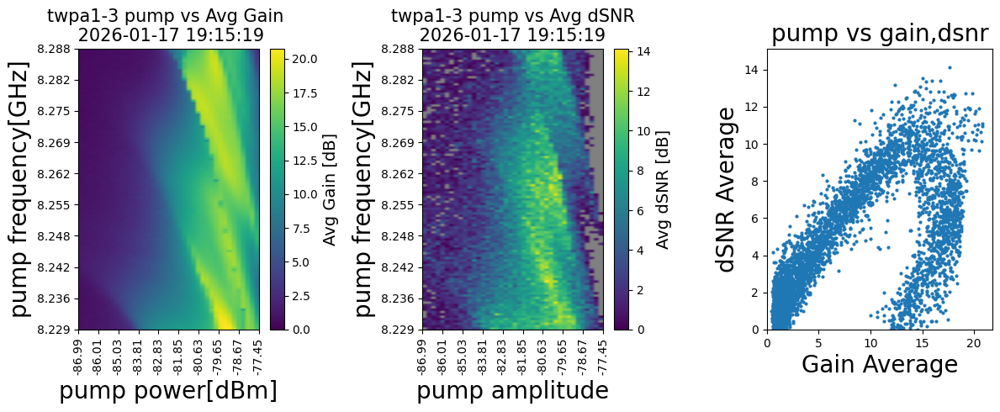

In [ ]:
time_sec = 1e-9 * 12 * n_avg * len(daps) * len(dfps) * len(dfs) * (
    machine.qubits[twpas[0].qubits[0]].resonator.operations["readout"].length +
    machine.qubits[twpas[0].qubits[0]].resonator.depletion_time
)
print(f"calibration time = {np.round(time_sec, 3)} sec")
pump_frequency=machine.twpas[twpa_].pump.LO_frequency+machine.twpas[twpa_].pump.intermediate_frequency+dfps
pump_power=opxoutput(full_scale_power_dbm,daps)+node.parameters.pumpline_attenuation
pump_power[np.isneginf(pump_power)]=0
indices=np.linspace(0, len(pump_frequency)-1,10, dtype=int)
selected_frequencies=np.round(pump_frequency[indices]*1e-9,3)
ytick_pos = np.linspace(0, len(dfps)-1, len(selected_frequencies))
indices_=np.linspace(0, len(pump_power)-1,10, dtype=int)
selected_powers=np.round(pump_power[indices_],2)
xtick_pos = np.linspace(0, len(daps)-1, len(selected_powers))
##---------------------------- SIGNAL S21 PLOT -----------------------------------------------
ncols = 2
nrows = math.ceil(len(qubits) / ncols)
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8)) 
axes = axes.flatten() 
for i, ax in enumerate(axes):
    if i < len(qubits):  # only plot existing qubits
        ax.plot(RF_freq[i]*1e-9, ds.IQ_abs_signal.values[i][0][0], label='pumpoff',color='black') #[0][0] arbitrary n_avg number of averaged S21 data
        ax.plot(RF_freq[i]*1e-9,ds_.IQ_abs_signal.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]], label='pump @ max avg G',color='red')
        ax.plot(RF_freq[i]*1e-9, ds_.IQ_abs_signal.values[i][pumpATmaxDSNR[1][0]][pumpATmaxDSNR[1][1]], label='pump @ max avg Dsnr',color='blue')
        ax.set_title(f'{qubits[i].name} Signal S21 \n {date_time}', fontsize=14)
        ax.set_xlabel('Res.freq [GHz]', fontsize=12)
        ax.set_ylabel('Trans.amp. [mV]', fontsize=12)
        ax.legend(fontsize=4, loc='upper right')
    else:
        ax.axis("off")  
plt.tight_layout()
s=plt.gcf()
plt.show()
##-----------------------------------Noise PLOT-----------------------------------------
fig, axes = plt.subplots(nrows, ncols, figsize=(6, 8)) 
axes = axes.flatten() 
for i, ax in enumerate(axes):
    if i < len(qubits):  # only plot existing qubits
        ax.plot(RF_freq[i]*1e-9, ds.IQ_abs_noise.values[i][0][0], label='pumpoff',color='black') #[0][0] arbitrary n_avg number of averaged S21 data
        ax.plot(RF_freq[i]*1e-9,ds_.IQ_abs_noise.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]], label='pump @ maxG',color='red')
        ax.plot(RF_freq[i]*1e-9, ds_.IQ_abs_noise.values[i][pumpATmaxDSNR[1][0]][pumpATmaxDSNR[1][1]], label='pump @ maxDsnr',color='blue')
        ax.set_title(f'{qubits[i].name}, Noise\n {date_time}', fontsize=14)
        ax.set_xlabel('Res.freq [GHz]', fontsize=12)
        ax.set_ylabel('Trans.amp. [mV]', fontsize=12)
        ax.set_ylim(0, max(ds_.IQ_abs_signal.values[i][pumpATmaxG[1][0]][pumpATmaxG[1][1]]))
        ax.legend(fontsize=4, loc='upper right')
    else:
        ax.axis("off")  
plt.tight_layout()
n=plt.gcf()
plt.show()

### ------------------------- avggain vs pump ----------------------------------------
fig, axs = plt.subplots(1, 3, figsize=(12,5))
cmap = plt.cm.viridis.copy()
cmap.set_under('gray')
# plot gain vs pump
im0 = axs[0].imshow(average_gain, origin='lower', aspect='auto',
                    extent=[0, len(daps)-1, 0, len(dfps)-1], cmap=cmap, vmin=0)
axs[0].set_xticks(xtick_pos)
axs[0].set_xticklabels(selected_powers,rotation=90)
axs[0].set_yticks(ytick_pos)
axs[0].set_yticklabels(selected_frequencies)
axs[0].set_title(f'{twpas[0].id} pump vs Avg Gain \n {date_time}', fontsize=15)
axs[0].set_xlabel('pump power[dBm]', fontsize=20)
axs[0].set_ylabel('pump frequency[GHz]', fontsize=20)
cbar0 = fig.colorbar(im0, ax=axs[0])
cbar0.set_label('Avg Gain [dB]', fontsize=14)
print(f'max Avg dSNR({np.round(20*np.log10(np.max(np.mean(linear_dsnr,axis=0))),2)}dB) \n at fp={np.round((p_lo+p_if+pumpATmaxDSNR[0][0])*1e-9,3)}GHz,Pp={np.round(node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,pumpATmaxDSNR[0][1]),2)},Pamp={np.round(pumpATmaxDSNR[0][1],3)} \n {date_time} \n {len(dfs)}*{len(daps)}*{len(dfps)}*{n_avg}')

# plot avgDdSNR vs pump
im1 = axs[1].imshow(average_dsnr, origin='lower', aspect='auto',
                    extent=[0, len(daps)-1, 0, len(dfps)-1], cmap=cmap, vmin=0)
axs[1].set_xticks(xtick_pos)
axs[1].set_xticklabels(selected_powers,rotation=90)
axs[1].set_yticks(ytick_pos)
axs[1].set_yticklabels(selected_frequencies)
axs[1].set_title(f'{twpas[0].id} pump vs Avg dSNR\n {date_time} ', fontsize=15)
axs[1].set_xlabel('pump amplitude', fontsize=20)
axs[1].set_ylabel('pump frequency[GHz]', fontsize=20)
cbar1 = fig.colorbar(im1, ax=axs[1])
cbar1.set_label('Avg dSNR [dB]', fontsize=14)
# plot gain, dsnr : TWPA SPEC
axs[2].scatter(average_gain, average_dsnr, s=4)
axs[2].set_title('pump vs gain,dsnr', fontsize=20)
axs[2].set_xlabel('Gain Average', fontsize=20)
axs[2].set_ylabel('dSNR Average', fontsize=20)
axs[2].set_xlim(0,np.max(average_gain)+1)
axs[2].set_ylim(0,np.max(average_dsnr)+1)
plt.tight_layout()
map=plt.gcf()
plt.show()

In [ ]:
avg_operation_point={'fp':np.round((p_lo+p_if+dfps[avg_optimized_pump[0]]),3), 
                 'Pp': node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[avg_optimized_pump[1]]),
                 'Pamp': np.round(daps[avg_optimized_pump[1]],3)}
node.results["avg_operation_point"] = avg_operation_point
node.results["multiplexed_RO_operation_point"]={'fp':np.round((p_lo+p_if+dfps[mtplx_optimized_pump_idx[0]]),3), 
                 'Pp': node.parameters.pumpline_attenuation+opxoutput(full_scale_power_dbm,daps[mtplx_optimized_pump_idx[1]]),
                 'Pamp': np.round(daps[mtplx_optimized_pump_idx[1]],3)}
node.results["Ps"]={"Ps":readout_power}
node.results["figures"]={"signal": s,
                         "noise": n,
                         "map": map,
                         "operation_window" : window,
                         "gain_indiv":gain_indiv,
                         "dsnr_indiv":dsnr_indiv,
                         "multiplexed_window": multiplexed_optimization}
if not node.parameters.load_data_id:
    with node.record_state_updates():        
        machine.twpas[twpa_].pump_frequency=dfps[avg_optimized_pump[0]]
        machine.twpas[twpa_].pump_amplitude=daps[avg_optimized_pump[1]]
        machine.twpas[twpa_].mltpx_pump_frequency=dfps[mtplx_optimized_pump_idx[0]]
        machine.twpas[twpa_].mltpx_pump_amplitude=daps[mtplx_optimized_pump_idx[1]]
        machine.twpas[twpa_].max_avg_gain=np.round(np.max(np.mean(average_gain,axis=0)))
        machine.twpas[twpa_].max_avg_snr_improvement=np.round(np.max(np.mean(average_dsnr,axis=0)))

In [ ]:
node.outcomes = {q.name: "successful" for q in qubits}
node.results["initial_parameters"] = node.parameters.model_dump()
node.machine = machine
node.save()

2026-01-18 15:49:51,292 - INFO - Saving node with snapshot index 3253
2026-01-18 15:49:51,318 - qualibrate - INFO - Saving node 00a_twpa1_3_calibration_MTPLX_RO to local storage
2026-01-18 15:49:52,862 - qualibrate - INFO - Saving machine to active path C:\Users\KimJeongwon\qw_statestore_QCC\quam_state
2026-01-18 15:49:52,920 - qualibrate - INFO - Saving machine to data folder C:\Users\KimJeongwon\.qualibrate\user_storage\JWKim\2026-01-18\#3270_00a_twpa1_3_calibration_MTPLX_RO_154951\quam_state
2026-01-18 15:49:52,970 - INFO - Node saved locally
2026-01-18 15:49:52,976 - INFO - Found quantum computer backend: arbel
2026-01-18 15:50:04,940 - INFO - Node successfully uploaded to cloud
